In [1]:
!pip install torch torchvision


This cell installs the torch and torchvision libraries, which are essential for building and using deep learning models, particularly for tasks involving computer vision.

torch: The main library for PyTorch, which is a popular deep learning framework.
torchvision: Provides utilities for image processing, datasets, and model architectures that are pre-trained.

### **LOAD DATA**






In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import json
with open('/content/drive/MyDrive/Brain_Tumor_Segmentation/valid/_annotations.coco.json','r') as file:
    data = json.load(file)

for img in data['images'][:10]:
    print(img['file_name'])

1997_jpg.rf.57e306420710246d04c0d5c26e6496c6.jpg
2422_jpg.rf.59a35b6d8d2eed150af8535cf09bbde5.jpg
1630_jpg.rf.5afc6e25d7987503a11bcb0791b60b53.jpg
1330_jpg.rf.5b23bf18a29b0f50e376b19a5a84f823.jpg
2768_jpg.rf.5b87c0023909e0789a33185a3aab92e9.jpg
2647_jpg.rf.5ba404374f2d670f04a2d1367c77c039.jpg
1511_jpg.rf.5c02bb67a267960293c9e8393c2d9380.jpg
1018_jpg.rf.5c6fcb4480745ff7c60c7305781913ab.jpg
1694_jpg.rf.5c8d647ce366cbd41426af5217863bd4.jpg
2824_jpg.rf.5ca7452639b345dfd0206a58531b6910.jpg


This cell reads a JSON file containing annotations for the brain tumor segmentation dataset. The file is in COCO format, a common format for image annotations. The code prints the file names of the first 10 images in the dataset.

json.load(file): Loads the JSON data from the file into a Python dictionary.

data['images']: Accesses the list of images in the dataset.

print(img['file_name']): Prints the file name of each image.


In [4]:
import json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os

### **EDA**


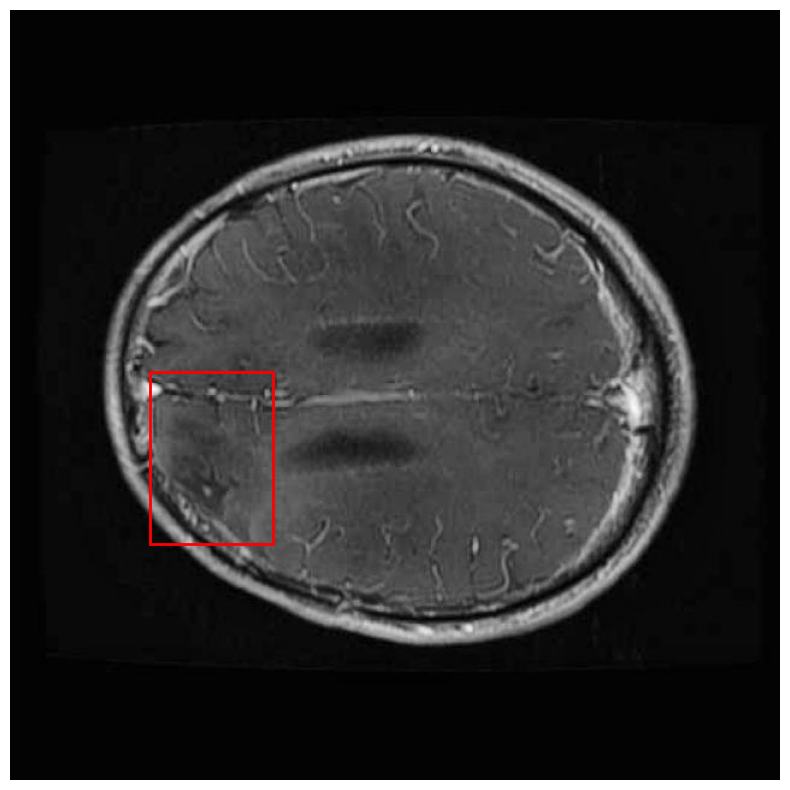

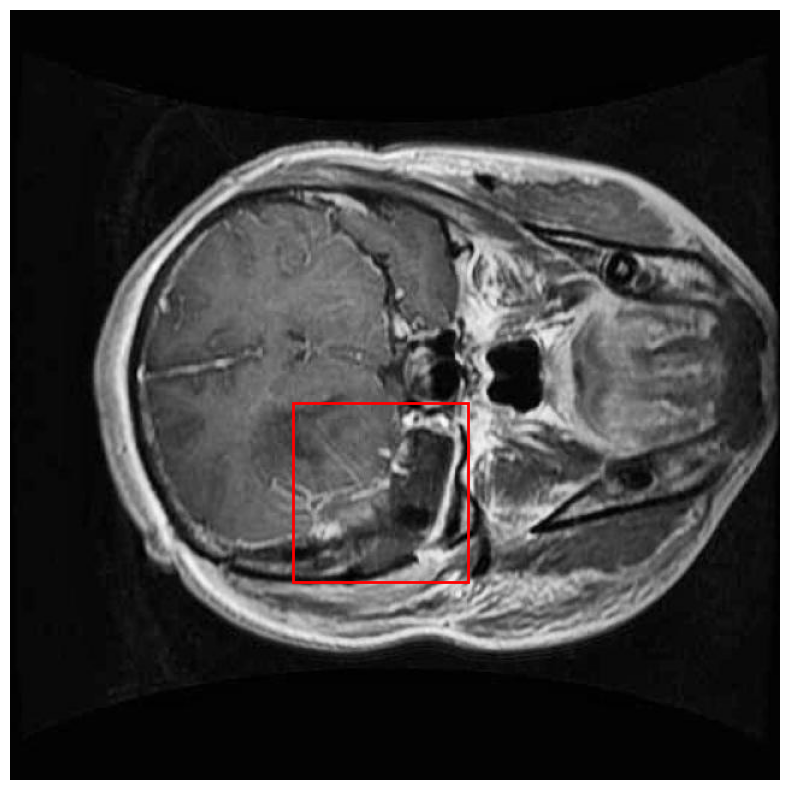

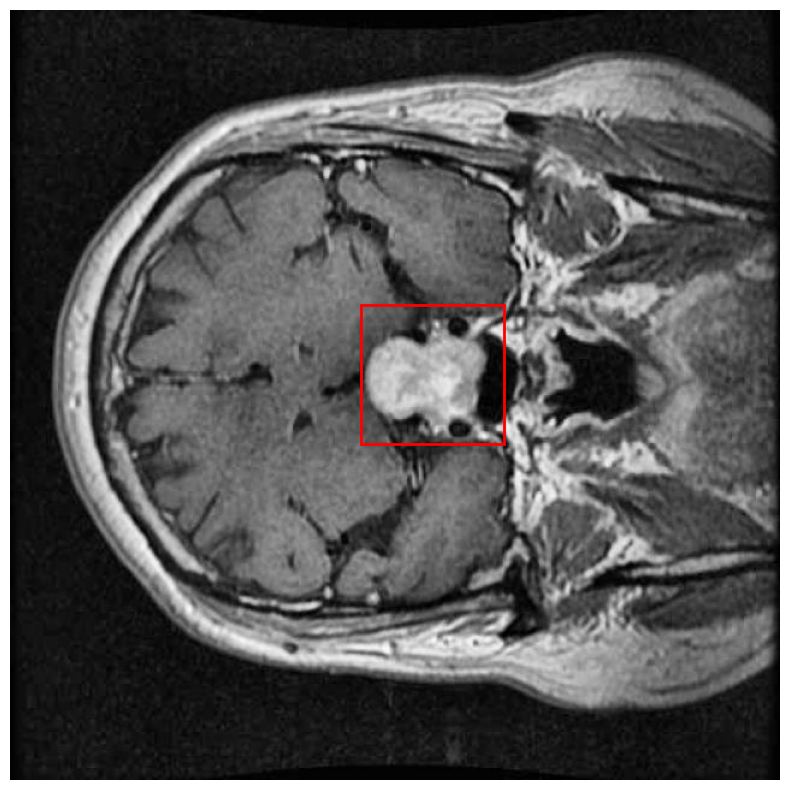

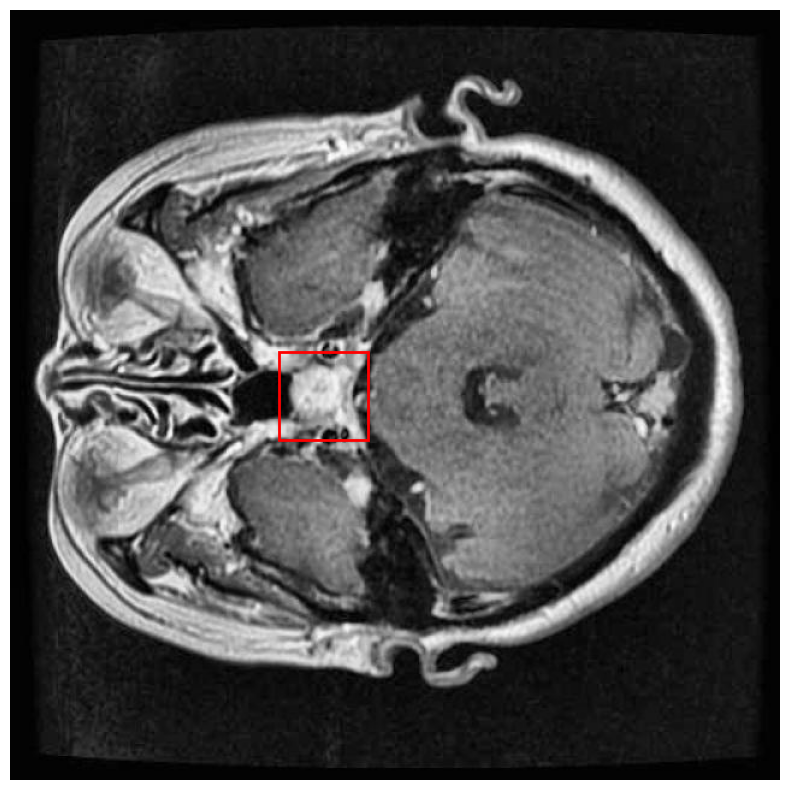

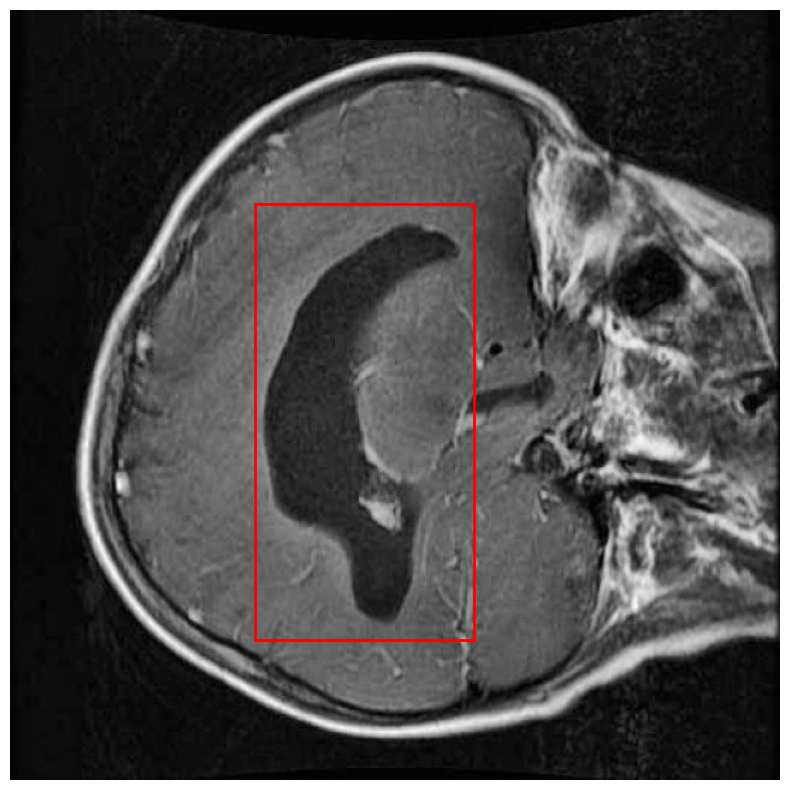

...

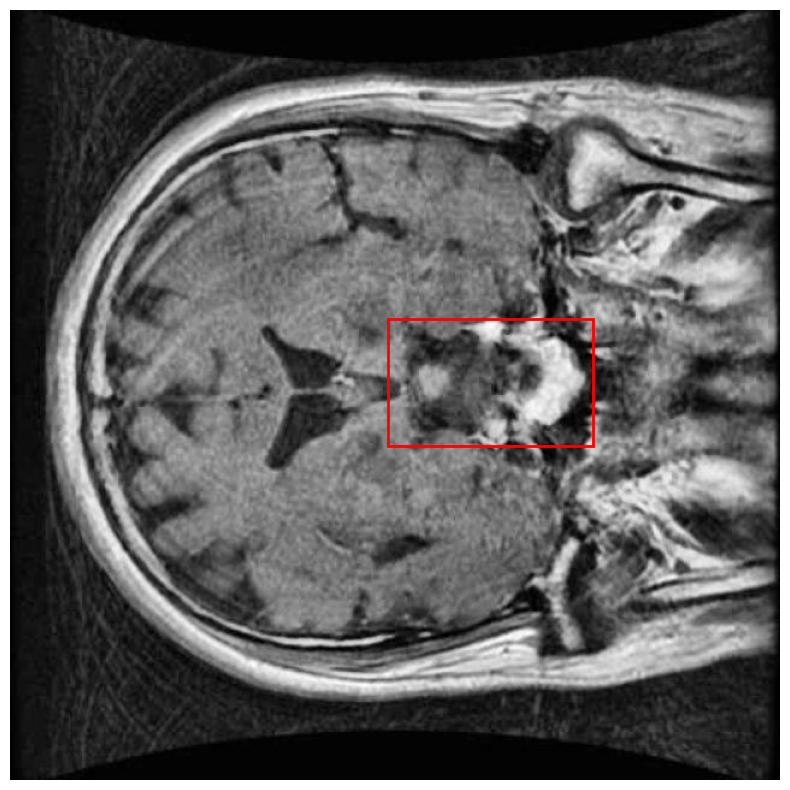

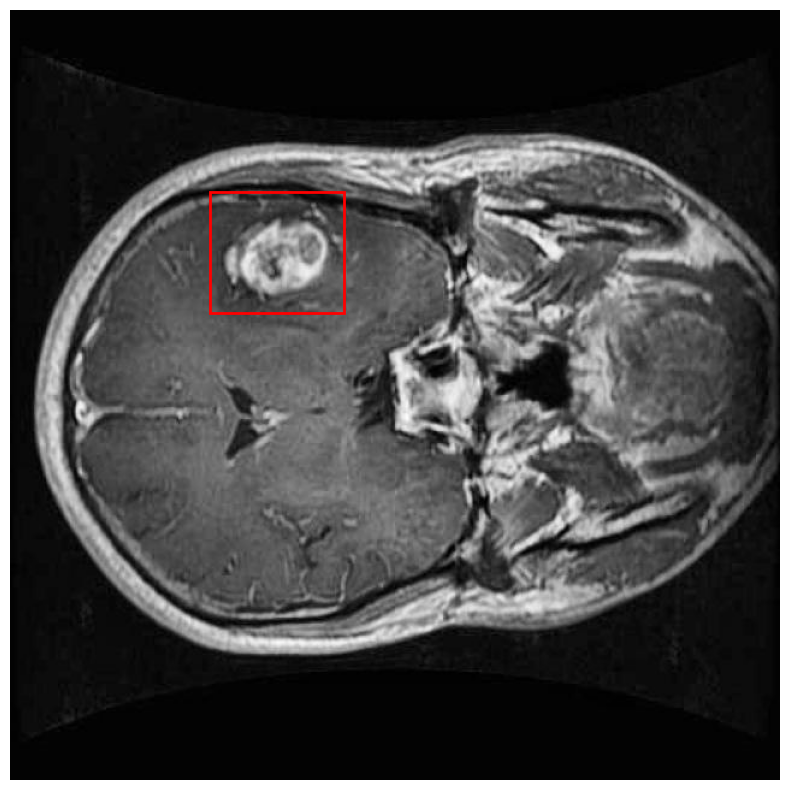

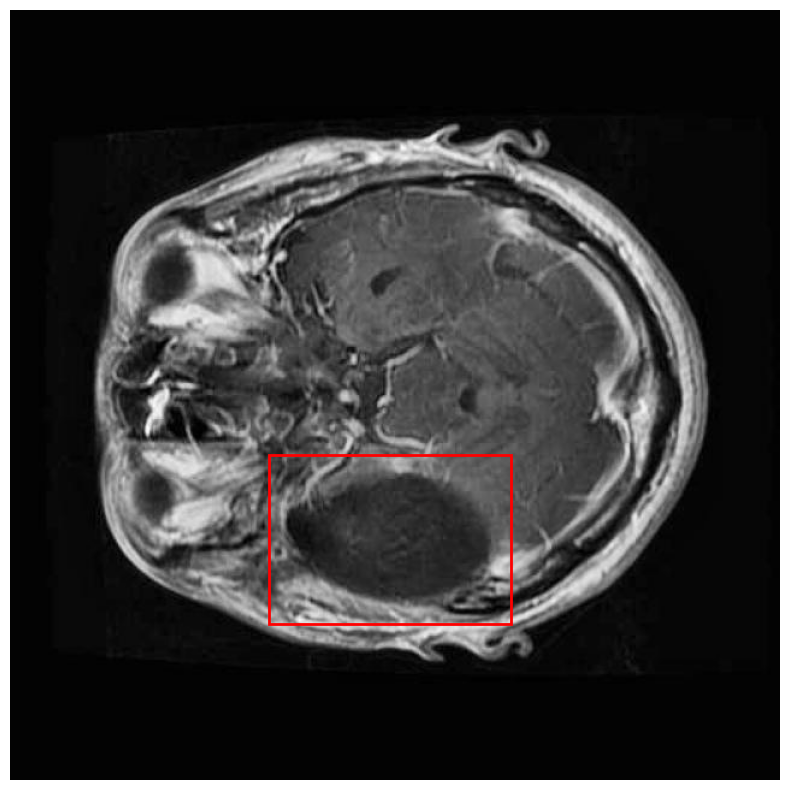

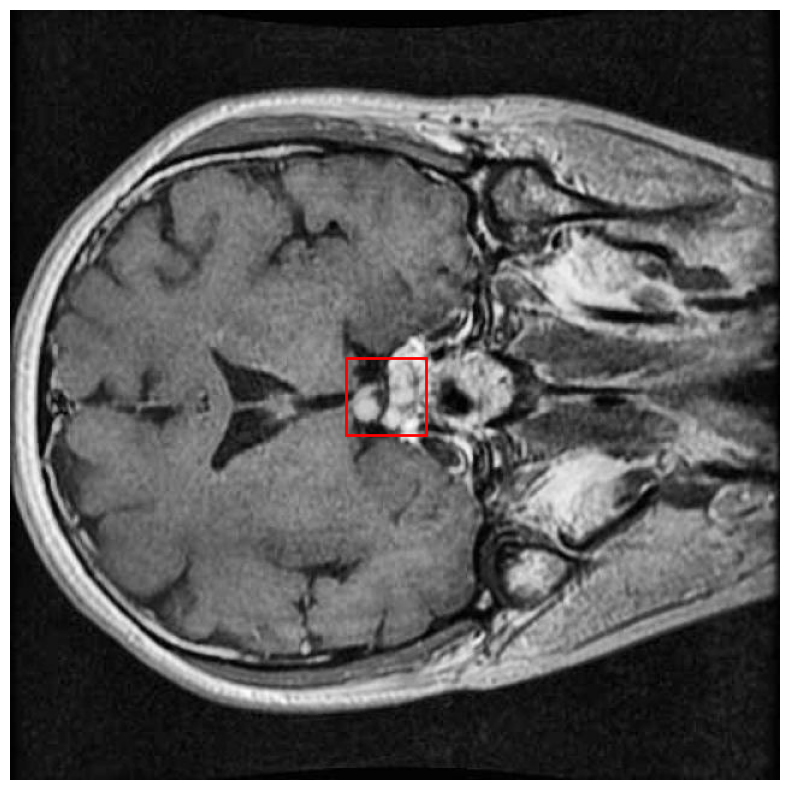

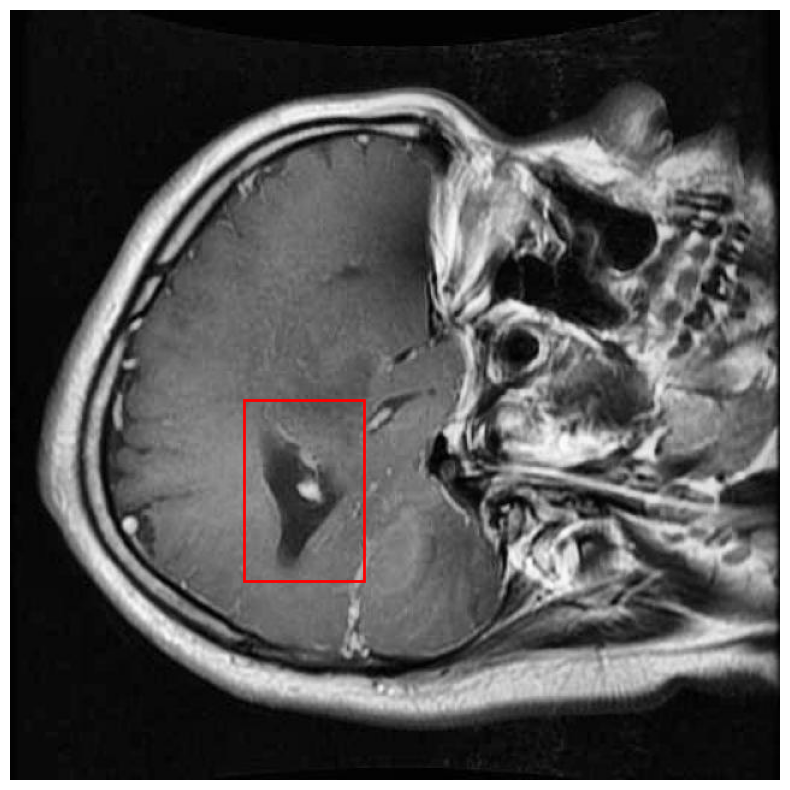

In [5]:

# Define the function to display images with annotations
def display_image_with_annotations(img_data, annotations, image_dir):
    file_name = img_data['file_name']
    img_path = os.path.join(image_dir, file_name)

    # Load the image
    image = Image.open(img_path)
    plt.figure(figsize=(10, 10))
    plt.imshow(image)

    img_id = img_data['id']
    img_annotations = [ann for ann in annotations if ann['image_id'] == img_id]

    ax = plt.gca()

    # Draw bounding boxes on the image
    for ann in img_annotations:
        bbox = ann['bbox']
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

    plt.axis('off')
    plt.show()

# Load the annotations JSON file
annotations_path = '/content/drive/MyDrive/Brain_Tumor_Segmentation/valid/_annotations.coco.json'
with open(annotations_path) as f:
    data = json.load(f)

image_dir = '/content/drive/MyDrive/Brain_Tumor_Segmentation/valid/images'

# Display the first 10 images with annotations
for img in data['images'][:20]:
    display_image_with_annotations(img, data['annotations'], image_dir)


This script loads image metadata and annotations from a JSON file, displays the first 10 images in the specified directory, and overlays bounding boxes on these images based on the annotations

The code loads a set of image annotations from a JSON file, then iterates through a subset of images, displaying each image along with its associated bounding box annotations. This can be particularly useful for visualizing and verifying the annotations in a dataset.

### **CHANGE JSON to MASK**

In [6]:
import numpy as np
import skimage.draw
import tifffile
import shutil

def create_mask(image_info, annotations, output_folder, max_print=3):

    mask_np = np.zeros((image_info['height'], image_info['width']), dtype=np.uint8)
    object_number = 1
    printed_masks = 0  # Count the number of printed masks
    for ann in annotations:
        if ann['image_id'] == image_info['id']:
            for seg_idx, seg in enumerate(ann['segmentation']):
                rr, cc = skimage.draw.polygon(seg[1::2], seg[0::2], mask_np.shape)

                seg_mask = np.zeros_like(mask_np, dtype=np.uint8)
                seg_mask[rr, cc] = 255
                mask_path = os.path.join(output_folder, f"{image_info['file_name'].replace('.jpg', '')}_seg_{seg_idx}.tif")
                tifffile.imwrite(mask_path, seg_mask)
                printed_masks += 1
                if printed_masks >= max_print:
                    return

The create_mask function - creates a blank mask for an image, iterates through annotations to find those that belong to the current image , draws polygons for each segmentation in the annotation , saves the masks as TIFF files in the specified output folder and limits the number of saved masks to the value of max_print.

In [7]:
def main(json_file, mask_output_folder, image_output_folder, original_image_dir):
    # Load COCO JSON annotations
    with open(json_file, 'r') as f:
        data = json.load(f)

    images = data['images']
    annotations = data['annotations']

    # Ensure the output directories exist
    if not os.path.exists(mask_output_folder):
        os.makedirs(mask_output_folder)
    if not os.path.exists(image_output_folder):
        os.makedirs(image_output_folder)

    for img in images:
        create_mask(img, annotations, mask_output_folder)

        original_image_path = os.path.join(original_image_dir, img['file_name'])
        new_image_path = os.path.join(image_output_folder, os.path.basename(original_image_path))
        shutil.copy2(original_image_path, new_image_path)

This script loads image metadata and annotations from a COCO JSON file , creates masks for each image based on the annotations,ensures the existence of the output directories and copies the original images to the specified output directory.

In [8]:
original_image_dir = '/content/drive/MyDrive/Brain_Tumor_Segmentation/test/images'
json_file = '/content/drive/MyDrive/Brain_Tumor_Segmentation/test/_annotations.coco.json'
mask_output_folder = 'test2/masks'
image_output_folder = 'test2/images'
main(json_file, mask_output_folder, image_output_folder, original_image_dir)

original_image_dir = '/content/drive/MyDrive/Brain_Tumor_Segmentation/train/images'
json_file = '/content/drive/MyDrive/Brain_Tumor_Segmentation/train/_annotations.coco.json'
mask_output_folder = 'train2/masks/'
image_output_folder = 'train2/images'
main(json_file, mask_output_folder, image_output_folder, original_image_dir)

original_image_dir = '/content/drive/MyDrive/Brain_Tumor_Segmentation/valid/images'
json_file = '/content/drive/MyDrive/Brain_Tumor_Segmentation/valid/_annotations.coco.json'
mask_output_folder = 'valid2/masks'
image_output_folder = 'valid2/images'
main(json_file, mask_output_folder, image_output_folder, original_image_dir)

In [9]:
def compare_folders_and_delete(folder1_path, folder2_path):
    folder1_items = os.listdir(folder1_path)
    folder2_items = os.listdir(folder2_path)

    for item1 in folder1_items:
        found = False
        for item2 in folder2_items:
            if item1[:4] == item2[:4]:
                found = True
                break
        if not found:
            print(f"Corresponding item for {item1} not found.")
            item1_path = os.path.join(folder1_path, item1)
            os.remove(item1_path)
            print(f"Deleted {item1}")

    for item2 in folder2_items:
        found = False
        for item1 in folder1_items:
            if item2[:4] == item1[:4]:
                found = True
                break
        if not found:
            print(f"Corresponding item for {item2} not found.")
            item2_path = os.path.join(folder2_path, item2)
            os.remove(item2_path)
            print(f"Deleted {item2}")

# Example usage:
folder1_path = "/content/valid2/images"
folder2_path = "/content/valid2/masks"
compare_folders_and_delete(folder1_path, folder2_path)

This code compares two folders and deletes files from each folder if there is no corresponding file in the other folder. It first lists all items in both folders, then checks if the first four characters of filenames match. If a match is not found, the unmatched file is deleted. Finally, it repeats the process for the second folder to ensure symmetry.

Global Variable

In [10]:
BATCH_SIZE = 8
NUM_EPOCHS = 35
LEARNING_RATE =1e-3

Create Custom Dataset for PyTorch

In [11]:
import os
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from PIL import Image

class CustomDataset_general(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.image_folder = os.path.join(root_dir, "images")
        self.mask_folder = os.path.join(root_dir, "masks")
        self.image_files = sorted(os.listdir(self.image_folder))
        self.mask_files = sorted(os.listdir(self.mask_folder))
        self.transform = transform

    def __len__(self):
        return len(self.mask_files)

    def __getitem__(self, idx):
        # Read image
        img_name = self.image_files[idx]
        img_path = os.path.join(self.image_folder, img_name)
        image = Image.open(img_path).convert("RGB")
        image_gray = image.convert("L")  # Convert to grayscale

        # Read corresponding mask
        mask_name = self.mask_files[idx]
        mask_path = os.path.join(self.mask_folder, mask_name)
        mask = Image.open(mask_path).convert("L")

        if self.transform:
            # Apply transformations
            image_gray = self.transform(image_gray)
            mask = self.transform(mask)

        return image_gray, mask

train_path = "/content/train2"
valid_path = "/content/valid2"
test_path = "/content/test2"

image_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485], std=[0.229]),  # Assuming grayscale images
    transforms.Lambda(lambda x: x.clamp(0, 1))
])

# Create datasets
train_dataset = CustomDataset_general(train_path, transform=image_transform)
valid_dataset = CustomDataset_general(valid_path, transform=image_transform)
test_dataset = CustomDataset_general(test_path, transform=image_transform)

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)


This code sets up a custom dataset for image and mask pairs using PyTorch. It initializes directories for images and masks, loads the files, and applies transformations such as resizing, tensor conversion, and normalization. The dataset class fetches and transforms each image-mask pair by index. Paths for training, validation, and test datasets are defined. Transformations are composed to prepare the images and masks. Data loaders are created to handle batching and shuffling for training, validation, and testing processes.

In [12]:
print(len(train_loader))

188


In [13]:
# Define the U-Net model
import torch.nn as nn
import torch.nn.functional as F

In [14]:
class UNet(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UNet, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.middle = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, out_channels, kernel_size=1)
        )
    def forward(self, x):
        enc = self.encoder(x)
        mid = self.middle(enc)
        dec = self.decoder(mid)
        return dec


This code defines a simple U-Net architecture for image segmentation using PyTorch. The `UNet` class inherits from `nn.Module`. The constructor (`__init__`) sets up three main parts: the encoder, middle, and decoder. The encoder performs two convolutional operations with ReLU activations and max-pooling to downsample the input. The middle section further processes the feature maps with additional convolutions and max-pooling. The decoder upsamples the feature maps using a transposed convolution and then applies additional convolutions and ReLU activations to generate the final output. The `forward` method defines the forward pass through the encoder, middle, and decoder, returning the segmented output.

In [15]:
import os
import torch
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import json

In [16]:
# Define model, loss function, and optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet(in_channels=3, out_channels=1).to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)


Model 1: UnFreeze All Layers

In [17]:
%pip install -U git+https://github.com/jlcsilva/segmentation_models.pytorch


  Cloning https://github.com/jlcsilva/segmentation_models.pytorch to /tmp/pip-req-build-99bsq7x6
  Running command git clone --filter=blob:none --quiet https://github.com/jlcsilva/segmentation_models.pytorch /tmp/pip-req-build-99bsq7x6
  Resolved https://github.com/jlcsilva/segmentation_models.pytorch to commit 44a5593bfb1c8f2a3f5f23303c02e6f7e2f11170
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 377.0/377.0 kB 22.8 MB/s eta 0:00:00
  Created wheel for segmentation_models_pytorch: filename=segmentation_models_pytorch-0.1.3-py3-none-any.whl size=96319 sha256=5ca4955b5fe7366476280d885dd7adacdab64a764406986fa7143014d13e22a2
  Stored in directory: /tmp/pip-ephem-wheel-cache-c22jt2j2/wheels/be/18/e0/89efe42be0510c4da2b477afd158be3064fffe98485f27da3d
  Created wheel for efficientnet-pytorch: fi

 %pip install -U: The %pip is a command to install packages. The -U  stands for "upgrade", which installs the latest version of the package.

git+ : tells pip that the package should be installed from a Git repository. The URL following it points to the specific GitHub repository from which the package should be installed.

"segmentation_models.pytorch" package includes tools and models for segmentation tasks using PyTorch.

In [18]:
import torch
from torchvision import datasets
# from torchmetrics.classification import JaccardIndex
from torch.utils.data import Dataset ,DataLoader
from torchvision.transforms import ToTensor
import torch.nn as nn
import pandas as pd
import numpy as np
from torch.optim import lr_scheduler

In [19]:
%pip install torchsummary

This command installs the `torchsummary` package, which provides a summary of the model architecture in PyTorch, including the number of parameters and output shape for each layer.

Loss

In [20]:
import torch.nn.functional as F

class DiceLoss(nn.Module):
    def __init__(self):
        super(DiceLoss, self).__init__()

    def forward(self, y_pred, y_true):
        y_pred = torch.sigmoid(y_pred)
        smooth = 1.0
        y_pred = y_pred.reshape(-1)
        y_true = y_true.reshape(-1)
        intersection = (y_pred * y_true).sum()

        dic_loss = 1 - (2.0 * intersection + smooth) / (y_pred.sum() + y_true.sum() + smooth)
        return dic_loss

This code defines a custom loss function called **DiceLoss**, used in image segmentation tasks. It calculates how well the predicted and actual masks overlap by using a measure called the **Dice coefficient**.

The function takes the predicted and true masks, applies a sigmoid function to scale the predictions, and then computes the Dice loss, which helps the model learn by penalizing differences between the predicted and actual masks.

In [21]:
import segmentation_models_pytorch as smp
import torch.nn as nn
import torchsummary

class ModifiedUnet(smp.Unet):
    def __init__(self, encoder_name, encoder_weights, in_channels, classes, activation):
        super(ModifiedUnet, self).__init__(
            encoder_name=encoder_name,
            encoder_weights=encoder_weights,
            in_channels=in_channels,
            classes=classes,
            activation=activation
        )

        self.encoder = self.add_batchnorm(self.encoder)

        self.decoder = self.add_dropout(self.decoder)

        self.classification_head = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Flatten(),
            nn.Linear(self.encoder.out_channels[-1], 64),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(64, 1)
        )

    def add_batchnorm(self, module):
        for name, layer in module.named_children():
            if isinstance(layer, nn.Conv2d):
                module.add_module(name, nn.Sequential(layer, nn.BatchNorm2d(layer.out_channels)))
            elif isinstance(layer, nn.Sequential) or isinstance(layer, nn.ModuleList):
                self.add_batchnorm(layer)
        return module

    def add_dropout(self, module):
        for name, layer in module.named_children():
            if isinstance(layer, nn.Conv2d):
                module.add_module(name, nn.Sequential(layer, nn.Dropout(0.5)))
            elif isinstance(layer, nn.Sequential) or isinstance(layer, nn.ModuleList):
                self.add_dropout(layer)
        return module

    def forward(self, x):
        features = self.encoder(x)
        decoder_output = self.decoder(*features)
        masks = self.segmentation_head(decoder_output)

        # Applying classification head
        classification_output = self.classification_head(features[-1])

        return masks

# Define constants
ENCODER = 'efficientnet-b0'
ENCODER_WEIGHTS = 'imagenet'
DEVICE = 'cuda'
ACTIVATION = None

model1 = ModifiedUnet(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    in_channels=1,
    classes=1,
    activation=ACTIVATION,
)

model1.to(DEVICE)
print(torchsummary.summary(model1, (1, 224, 224)))
optimizer1 = torch.optim.Adam(model1.parameters(), lr=LEARNING_RATE)

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b0-355c32eb.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b0-355c32eb.pth
100%|██████████| 20.4M/20.4M [00:01<00:00, 16.0MB/s]


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
         ZeroPad2d-1          [-1, 1, 225, 225]               0
Conv2dStaticSamePadding-2         [-1, 32, 112, 112]             288
       BatchNorm2d-3         [-1, 32, 112, 112]              64
       BatchNorm2d-4         [-1, 32, 112, 112]              64
MemoryEfficientSwish-5         [-1, 32, 112, 112]               0
         ZeroPad2d-6         [-1, 32, 114, 114]               0
Conv2dStaticSamePadding-7         [-1, 32, 112, 112]             288
       BatchNorm2d-8         [-1, 32, 112, 112]              64
MemoryEfficientSwish-9         [-1, 32, 112, 112]               0
         Identity-10             [-1, 32, 1, 1]               0
Conv2dStaticSamePadding-11              [-1, 8, 1, 1]             264
MemoryEfficientSwish-12              [-1, 8, 1, 1]               0
         Identity-13              [-1, 8, 1, 1]               0
Conv2dStaticSame

This code creates a special U-Net model for segmenting images. It adds batch normalization and dropout layers to make the model more stable and prevent overfitting.

The model uses EfficientNet-B0 as the encoder, which is already trained on ImageNet. It is designed for grayscale images with one channel. The model also has an extra layer for classification tasks. The code sets up the model, shows its structure, and prepares an Adam optimizer for training.

In [22]:
checkpoints_path = "exp/checkpoints.pth"
os.makedirs("exp", exist_ok=True)

loss_fn = DiceLoss()

This code sets the file path for saving model checkpoints and ensures the directory exists. It also initializes the DiceLoss class to be used as the loss function for training.

In [23]:
def compute_iou(outputs, targets):
    intersection = torch.logical_and(outputs, targets).sum()
    union = torch.logical_or(outputs, targets).sum()
    iou = intersection.float() / union.float()
    return iou.item()

The compute_iou function calculates the Intersection over Union (IoU) metric. It computes the intersection and union of predicted (outputs) and true (targets) binary masks, then divides the intersection by the union to get the IoU value. The result is converted to a Python float and returned.

In [24]:
def train(model, optimizer, loss_fn, loader, device):
    epoch_loss = 0.0
    epoch_iou = 0.0
    model.train()

    for x, y in tqdm(loader):
        x = x.to(device, dtype=torch.float32)
        y = y.to(device, dtype=torch.float32)
        optimizer.zero_grad()

        masks = model(x)  # Split the output of the model
        loss = loss_fn(masks, y)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

        preds = (masks > 0.8).float()
        iou = compute_iou(preds, y)
        epoch_iou += iou

    return epoch_loss / len(loader), epoch_iou / len(loader)

The train function performs one epoch of training for the given model. It iterates through the data loader, calculates predictions and loss, performs backpropagation, and updates the model weights. It also computes the Intersection over Union (IoU) for evaluating performance and returns the average loss and IoU for the epoch.

In [25]:
def valid(model, loader, loss_fn, device):
    epoch_loss = 0.0
    epoch_iou = 0.0
    model.eval()

    with torch.no_grad():
        for x, y in loader:
            x = x.to(device, dtype=torch.float32)
            y = y.to(device, dtype=torch.float32)

            masks = model(x)
            loss = loss_fn(masks, y)
            epoch_loss += loss.item()

            # Compute IoU
            preds = (masks > 0.8).float()
            iou = compute_iou(preds, y)
            epoch_iou += iou

    return epoch_loss / len(loader), epoch_iou / len(loader)

The `valid` function evaluates the model on a validation dataset. It sets the model to evaluation mode, computes predictions and loss without updating the model weights, and calculates the Intersection over Union (IoU) for performance measurement. It then returns the average loss and IoU for the validation set.

In [26]:
from tqdm import tqdm
from IPython.display import clear_output

best_val_loss = float('inf')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
train_losses = []
val_losses = []
train_ious = []
val_ious = []
num_no_improve = 0

model1.to(device)

for epoch in range(NUM_EPOCHS):
    train_loss, train_iou = train(model1, optimizer1, loss_fn, train_loader, device)
    val_loss, val_iou = valid(model1, valid_loader, loss_fn, device)

    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_ious.append(train_iou)
    val_ious.append(val_iou)

    clear_output(wait=True)
    print(f'Epoch {epoch+1}/{NUM_EPOCHS}, Train Loss: {train_loss:.4f}, Train IoU: {train_iou:.4f}')
    print(f'Validation Loss: {val_loss:.4f}, Validation IoU: {val_iou:.4f}')

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        print("Saving the model")
        torch.save(model1.state_dict(), checkpoints_path)

    if val_loss > best_val_loss:
        best_dict = torch.load(checkpoints_path)
        print('Loading Best Model')
        model1.load_state_dict(best_dict)

    if len(val_losses) > 1:
        if val_loss <= best_val_loss:
            num_no_improve += 1
        else:
            num_no_improve = 0

    if num_no_improve >= 10:
        print("Early stopping")
        break

Epoch 35/35, Train Loss: 0.3056, Train IoU: 0.5410
Validation Loss: 0.4746, Validation IoU: 0.3804
Loading Best Model


This code snippet trains and validates the model over a number of epochs while tracking performance metrics:

1. **Setup**: Initializes variables for tracking best validation loss, device (GPU or CPU), loss and IoU metrics, and no-improvement count.

2. **Training Loop**:
   - For each epoch, it trains the model and validates it.
   - Appends the loss and IoU metrics to lists.
   - Clears previous output in the notebook for clean progress updates.
   - Prints the current epoch's train and validation loss and IoU.

3. **Model Checkpointing**:
   - Saves the model if the validation loss improves.
   - Loads the best model if validation loss worsens.
   - Implements early stopping if there is no improvement in validation loss for 10 consecutive epochs.

# or

This code trains and validates the model for a set number of epochs, tracking train and validation loss and IoU metrics. It saves the model if the validation loss improves, and reloads the best model if the validation loss worsens. If there's no improvement in validation loss for 10 epochs, it stops training early. Progress is updated and displayed for each epoch.

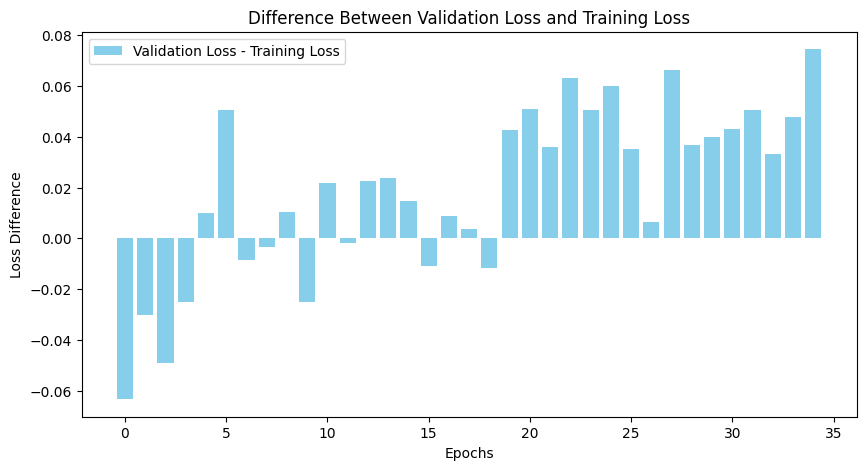

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming train_losses and val_losses are lists of losses
# Calculate the difference between validation loss and training loss
loss_diff = np.array(val_losses) - np.array(train_losses)

# Create a bar plot showing the differences
plt.figure(figsize=(10, 5))
plt.bar(range(len(loss_diff)), loss_diff, color='skyblue', label='Validation Loss - Training Loss')
plt.title('Difference Between Validation Loss and Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss Difference')
plt.legend()
plt.show(block=False)

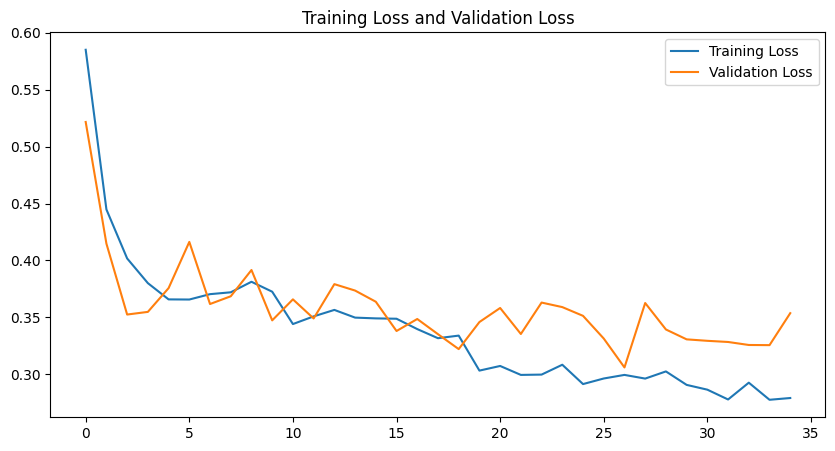

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training Loss and Validation Loss')
plt.legend()
plt.show(block=False)

This code plots the training and validation losses over epochs, with a figure size of 10x5 inches. It adds a title and legend, then displays the plot.

In [ ]:
test_loss = valid(model1,test_loader,loss_fn,device)
print(f'Test data DiceLoss, IOU : {test_loss}')

Test data DiceLoss, IOU : (0.3333082243248268, 0.5141232598710943)


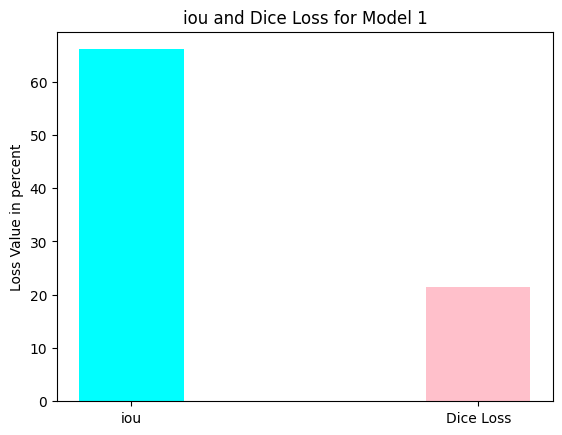

In [ ]:
import matplotlib.pyplot as plt

# Assuming test_loss is already calculated
iou = 66.069  # Example value
dice_loss = 21.442   # Example value, replace with actual Dice loss

# Data for the bar plot
loss_types = ['iou', 'Dice Loss']
loss_values = [iou, dice_loss]

# Create bar plot
plt.bar(loss_types, loss_values, color=['cyan', 'pink'],width=0.3)

# Add labels and title
plt.ylabel('Loss Value in percent')
plt.title('iou and Dice Loss for Model 1')

# Display the plot
plt.show()


This code evaluates the model on the test dataset by calculating the loss and IoU using the `valid` function, then prints the test loss and IoU values.

In [ ]:
import torch
import numpy as np
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score

# Function to compute metrics
def compute_metrics(true_mask, pred_mask):
    # Flatten masks to 1D arrays
    true_mask_flat = true_mask.flatten()
    pred_mask_flat = pred_mask.flatten()

    # Ensure both are binary (0 or 1)
    true_mask_flat = (true_mask_flat > 0.5).astype(np.uint8)
    pred_mask_flat = (pred_mask_flat > 0.5).astype(np.uint8)

    # Calculate precision, recall, accuracy, F1 score
    precision = precision_score(true_mask_flat, pred_mask_flat)
    recall = recall_score(true_mask_flat, pred_mask_flat)
    accuracy = accuracy_score(true_mask_flat, pred_mask_flat)
    f1 = f1_score(true_mask_flat, pred_mask_flat)

    return precision, recall, accuracy, f1

# Function to validate model and compute metrics
def valid(model, data_loader, device):
    model.eval()
    test_loss = 0
    dice_loss_list = []
    precision_list = []
    recall_list = []
    accuracy_list = []
    f1_list = []

    with torch.no_grad():
        for images, true_masks in data_loader:
            images = images.to(device)
            true_masks = true_masks.to(device)

            # Get model predictions
            preds = model(images)

            # Compute Dice loss (assuming you already implemented Dice loss in your notebook)
            dice_loss = DiceLoss()(preds, true_masks)  # Replace this with your actual Dice Loss function
            dice_loss_list.append(dice_loss.item())

            # Convert predictions and masks to CPU and numpy for metric calculation
            preds = preds.cpu().numpy()
            true_masks = true_masks.cpu().numpy()

            # Iterate through each image in the batch
            for pred_mask, true_mask in zip(preds, true_masks):
                # Ensure both predicted mask and true mask are binary
                pred_mask = (pred_mask > 0.5).astype(np.uint8)  # Binarize predictions
                true_mask = (true_mask > 0.5).astype(np.uint8)  # Binarize ground truth

                # Compute precision, recall, accuracy, and F1 score
                precision, recall, accuracy, f1 = compute_metrics(true_mask, pred_mask)
                precision_list.append(precision)
                recall_list.append(recall)
                accuracy_list.append(accuracy)
                f1_list.append(f1)

    avg_precision = np.mean(precision_list)
    avg_recall = np.mean(recall_list)
    avg_accuracy = np.mean(accuracy_list)
    avg_f1 = np.mean(f1_list)
    avg_dice_loss = np.mean(dice_loss_list)

    print(f'Precision: {avg_precision}')
    print(f'Recall: {avg_recall}')
    print(f'Accuracy: {avg_accuracy}')
    print(f'F1 Score: {avg_f1}')
    print(f'Average Dice Loss: {avg_dice_loss}')

    return avg_dice_loss, avg_precision, avg_recall, avg_accuracy, avg_f1

# Example usage with your test_loader
test_loss, precision, recall, accuracy, f1 = valid(model1, test_loader, device)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.p

Precision: 0.6826821423771589
Recall: 0.639665485410145
Accuracy: 0.9763316845633603
F1 Score: 0.6232647292114598
Average Dice Loss: 0.3333082243248268


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.p

Precision: 0.6826821423771589
Recall: 0.639665485410145
Accuracy: 0.9763316845633603
F1 Score: 0.6232647292114598
Average Dice Loss: 0.3333082243248268


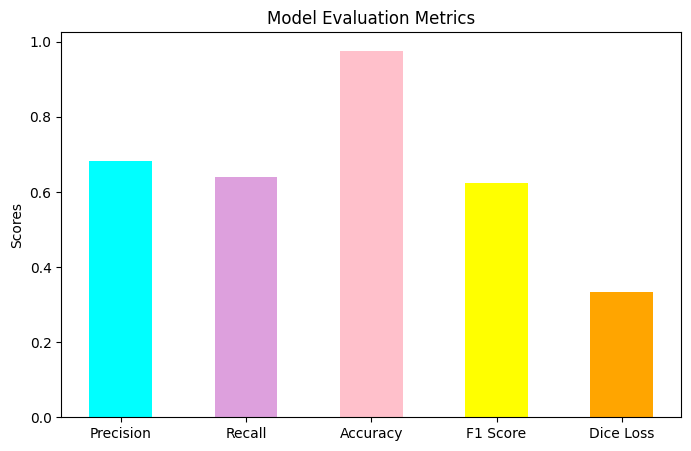

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Example usage with your test_loader (assuming valid function has been run)
test_loss, precision, recall, accuracy, f1 = valid(model1, test_loader, device)

# Create a list of metrics and their values
metrics = ['Precision', 'Recall', 'Accuracy', 'F1 Score', 'Dice Loss']
values = [precision, recall, accuracy, f1, test_loss]

# Plot the bar graph
plt.figure(figsize=(8, 5))
plt.bar(metrics, values, color=['cyan', 'plum', 'pink', 'yellow', 'orange'],width=0.5,align='center')

# Add labels and title
plt.ylabel('Scores')
plt.title('Model Evaluation Metrics')

# Show the plot
plt.show()


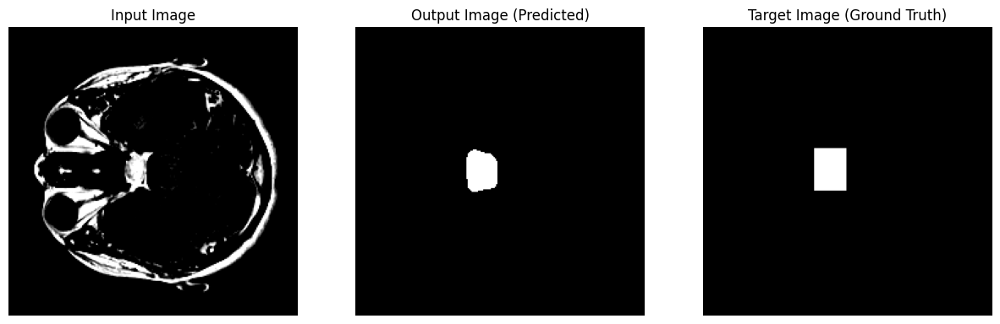

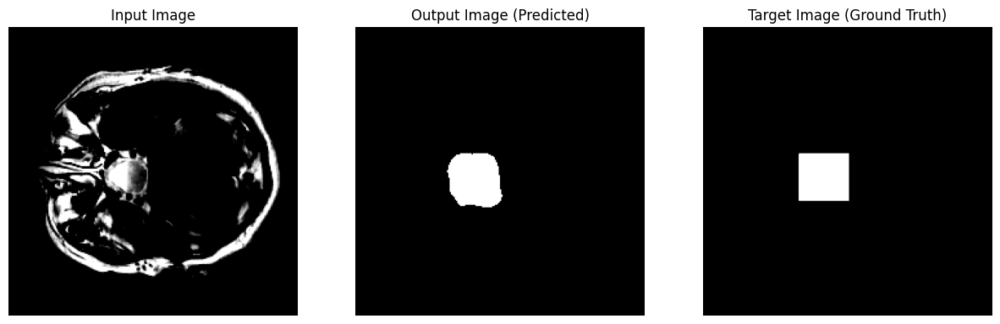

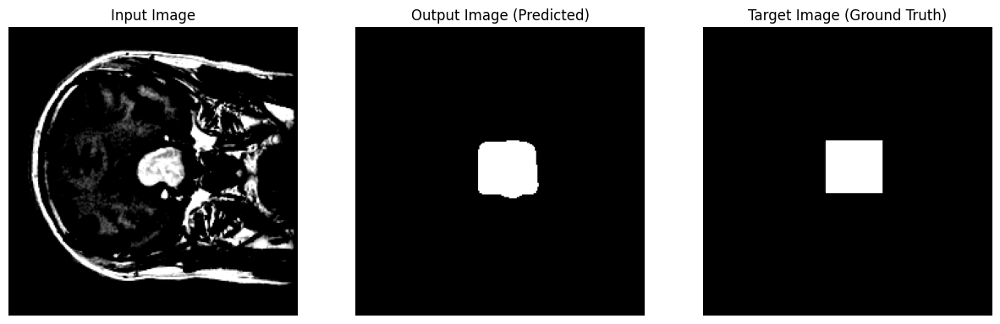

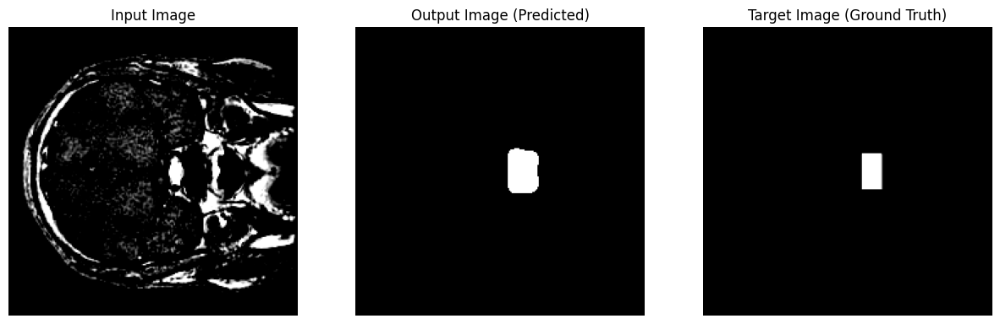

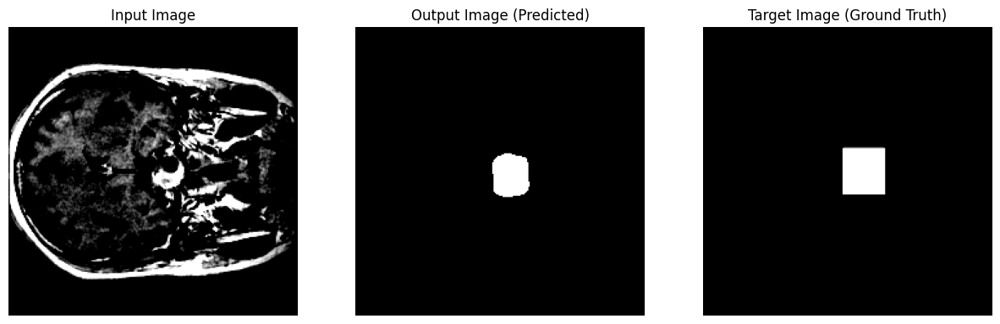

...

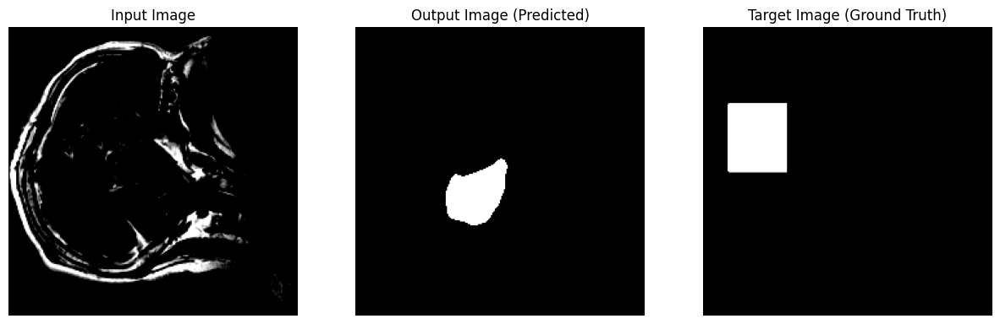

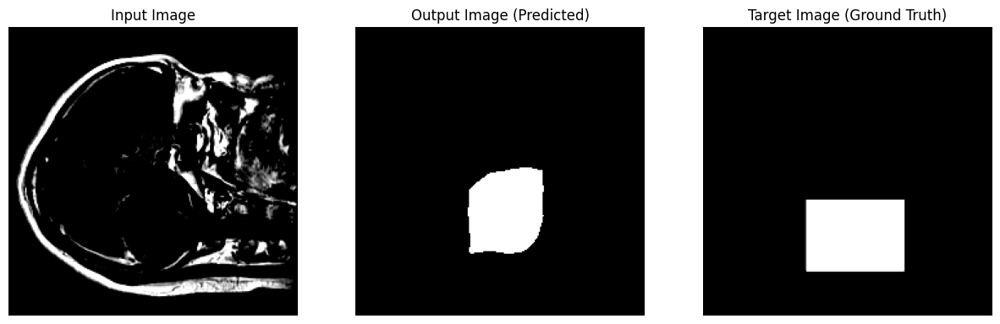

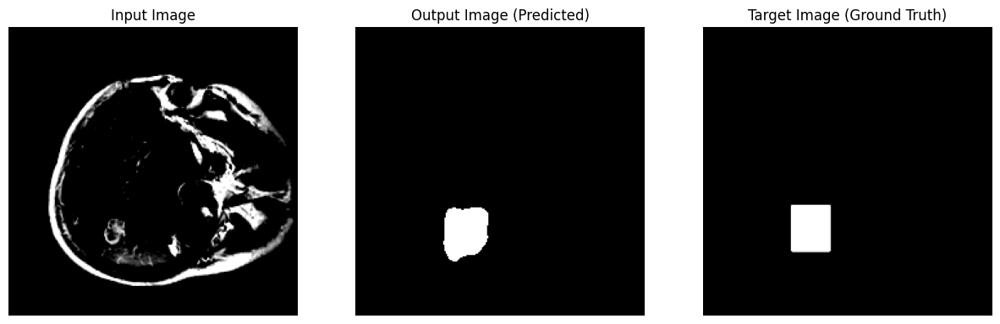

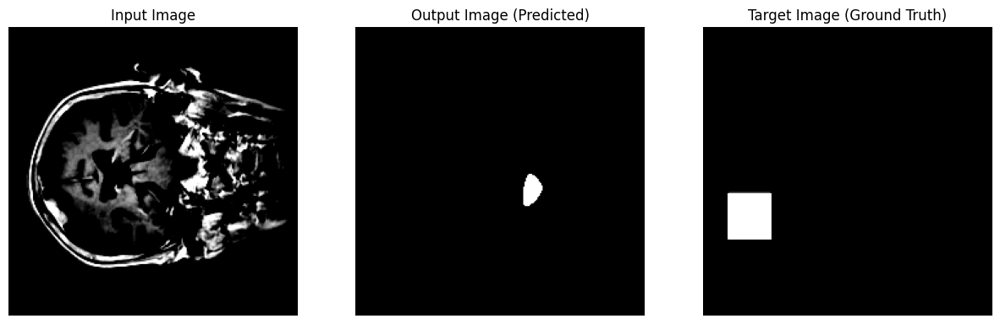

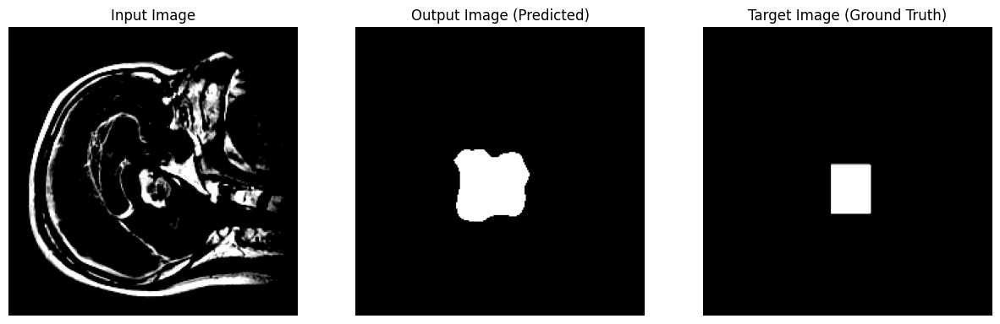

In [ ]:
def visualize_input_output_target(input_image, output_image, target_image):
    input_image = input_image.cpu()
    output_image = output_image.cpu()
    target_image = target_image.cpu()

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    axes[0].imshow(input_image.squeeze().numpy(), cmap='gray')
    axes[0].set_title('Input Image')
    axes[0].axis('off')

    axes[1].imshow(output_image.squeeze().numpy(), cmap='gray')
    axes[1].set_title('Output Image (Predicted)')
    axes[1].axis('off')

    axes[2].imshow(target_image.squeeze().numpy(), cmap='gray')
    axes[2].set_title('Target Image (Ground Truth)')
    axes[2].axis('off')

    plt.show()
    fig.savefig("output.png")


with torch.no_grad():
    for batch, (X, y) in enumerate(valid_loader):
        X = X.to(DEVICE, dtype=torch.float32)
        y = y.to(DEVICE, dtype=torch.float32)

        y_pred_logits = model1(X)

        y_pred = y_pred_logits[0]
        y_pred_binary = (y_pred > 0.5).float()

        visualize_input_output_target(X[0], y_pred_binary[0], y[0])

The `visualize_input_output_target` function displays and saves side-by-side images of the input, predicted output, and ground truth. The following loop processes validation data, generates predictions, converts them to binary, and visualizes these images using the function.

Model 2: Freeze all encoder layers

In [ ]:
import segmentation_models_pytorch as smp
import torch.nn as nn
import torchsummary

class ModifiedUnet(smp.Unet):
    def __init__(self, encoder_name, encoder_weights, in_channels, classes, activation):
        super(ModifiedUnet, self).__init__(
            encoder_name=encoder_name,
            encoder_weights=encoder_weights,
            in_channels=in_channels,
            classes=classes,
            activation=activation
        )

        self.encoder = self.add_batchnorm(self.encoder)

        self.decoder = self.add_dropout(self.decoder)

        self.classification_head = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Flatten(),
            nn.Linear(self.encoder.out_channels[-1], 64),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(64, 1)
        )

    def add_batchnorm(self, module):
        for name, layer in module.named_children():
            if isinstance(layer, nn.Conv2d):
                module.add_module(name, nn.Sequential(layer, nn.BatchNorm2d(layer.out_channels)))
            elif isinstance(layer, nn.Sequential) or isinstance(layer, nn.ModuleList):
                self.add_batchnorm(layer)
        return module

    def add_dropout(self, module):
        for name, layer in module.named_children():
            if isinstance(layer, nn.Conv2d):
                module.add_module(name, nn.Sequential(layer, nn.Dropout(0.5)))
            elif isinstance(layer, nn.Sequential) or isinstance(layer, nn.ModuleList):
                self.add_dropout(layer)
        return module

    def freeze_encoder(self):
        for param in self.encoder.parameters():
            param.requires_grad = False

    def forward(self, x):
        features = self.encoder(x)
        decoder_output = self.decoder(*features)
        masks = self.segmentation_head(decoder_output)

        classification_output = self.classification_head(features[-1])

        return masks

ENCODER = 'efficientnet-b0'
ENCODER_WEIGHTS = 'imagenet'
DEVICE = 'cuda'
ACTIVATION = None

model2 = ModifiedUnet(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    in_channels=1,
    classes=1,
    activation=ACTIVATION,
)

model2.freeze_encoder()

model2.to(DEVICE)
print(torchsummary.summary(model2, (1, 224, 224)))
optimizer2 = torch.optim.Adam(model2.parameters(), lr=LEARNING_RATE)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
         ZeroPad2d-1          [-1, 1, 225, 225]               0
Conv2dStaticSamePadding-2         [-1, 32, 112, 112]             288
       BatchNorm2d-3         [-1, 32, 112, 112]              64
       BatchNorm2d-4         [-1, 32, 112, 112]              64
MemoryEfficientSwish-5         [-1, 32, 112, 112]               0
         ZeroPad2d-6         [-1, 32, 114, 114]               0
Conv2dStaticSamePadding-7         [-1, 32, 112, 112]             288
       BatchNorm2d-8         [-1, 32, 112, 112]              64
MemoryEfficientSwish-9         [-1, 32, 112, 112]               0
         Identity-10             [-1, 32, 1, 1]               0
Conv2dStaticSamePadding-11              [-1, 8, 1, 1]             264
MemoryEfficientSwish-12              [-1, 8, 1, 1]               0
         Identity-13              [-1, 8, 1, 1]               0
Conv2dStaticSame

Imports: Import necessary libraries for segmentation, neural network layers, and model summary visualization.

Class Definition: Define ModifiedUnet, a custom U-Net model with added batch normalization and dropout layers.

Initialization: The model's encoder and decoder are modified by adding batch normalization and dropout.

Freeze Encoder: freeze_encoder() sets the encoder’s parameters to not require gradients, freezing its weights during training.

Model Creation: Instantiate ModifiedUnet with a specified encoder, weights, input channels, output classes, and activation function.

Device Transfer: Move the model to a specified computing device (e.g., CUDA for GPU acceleration).

Summary and Optimizer: Print a summary of the model’s architecture and configure the Adam optimizer for training.






In [ ]:
from tqdm import tqdm
from IPython.display import clear_output

best_val_loss = float('inf')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
train_losses = []
val_losses = []
train_ious = []
val_ious = []
num_no_improve = 0

model2.to(device)

# Validation function similar to the Kaggle notebook
def validate(model, val_loader, device):
    model.eval()  # Set the model to evaluation mode
    running_loss = 0.0
    iou_score = 0.0

    with torch.no_grad():
        for data, targets in val_loader:
            data, targets = data.to(device), targets.to(device)
            outputs = model(data)

            loss = loss_fn(outputs, targets)
            running_loss += loss.item()

            iou_score += compute_iou(outputs, targets)  # Custom IoU function

    val_loss = running_loss / len(val_loader)
    iou_score = iou_score / len(val_loader)

    return val_loss, iou_score

# Training loop
for epoch in range(NUM_EPOCHS):
    train_loss, train_iou = train(model2, optimizer2, loss_fn, train_loader, device)
    val_loss, val_iou = validate(model2, valid_loader, device)  # Note the change here

    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_ious.append(train_iou)
    val_ious.append(val_iou)

    clear_output(wait=True)
    print(f'Epoch {epoch+1}/{NUM_EPOCHS}, Train Loss: {train_loss:.4f}, Train IoU: {train_iou:.4f}')
    print(f'Validation Loss: {val_loss:.4f}, Validation IoU: {val_iou:.4f}')

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        print("Saving the model")
        torch.save(model2.state_dict(), checkpoints_path)

    if val_loss > best_val_loss:
        best_dict = torch.load(checkpoints_path)
        print('Loading Best Model')
        model2.load_state_dict(best_dict)

    if len(val_losses) > 1:
        if val_loss <= best_val_loss:
            num_no_improve += 1
        else:
            num_no_improve = 0

    if num_no_improve >= 10:
        print("Early stopping")
        break


100%|██████████| 188/188 [00:21<00:00,  8.69it/s]


Epoch 1/35, Train Loss: 0.6768, Train IoU: 0.2448
Validation Loss: 0.4950, Validation IoU: 0.0368
Saving the model


100%|██████████| 188/188 [00:21<00:00,  8.83it/s]


Epoch 2/35, Train Loss: 0.4847, Train IoU: 0.3597
Validation Loss: 0.4315, Validation IoU: 0.0368
Saving the model


100%|██████████| 188/188 [00:21<00:00,  8.80it/s]
<ipython-input-35-8797e590e252>:55: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_dict = torch.load(checkpoints_path)


Epoch 3/35, Train Loss: 0.4399, Train IoU: 0.3996
Validation Loss: 0.4399, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.03it/s]


Epoch 4/35, Train Loss: 0.4412, Train IoU: 0.3975
Validation Loss: 0.4191, Validation IoU: 0.0368
Saving the model


100%|██████████| 188/188 [00:20<00:00,  9.16it/s]


Epoch 5/35, Train Loss: 0.4160, Train IoU: 0.4219
Validation Loss: 0.4201, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.12it/s]


Epoch 6/35, Train Loss: 0.4191, Train IoU: 0.4196
Validation Loss: 0.4021, Validation IoU: 0.0368
Saving the model


100%|██████████| 188/188 [00:20<00:00,  8.96it/s]


Epoch 7/35, Train Loss: 0.3993, Train IoU: 0.4383
Validation Loss: 0.3878, Validation IoU: 0.0368
Saving the model


100%|██████████| 188/188 [00:21<00:00,  8.83it/s]


Epoch 8/35, Train Loss: 0.3710, Train IoU: 0.4672
Validation Loss: 0.3941, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.86it/s]


Epoch 9/35, Train Loss: 0.3707, Train IoU: 0.4688
Validation Loss: 0.3896, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.71it/s]


Epoch 10/35, Train Loss: 0.3770, Train IoU: 0.4619
Validation Loss: 0.3737, Validation IoU: 0.0368
Saving the model


100%|██████████| 188/188 [00:21<00:00,  8.81it/s]


Epoch 11/35, Train Loss: 0.3556, Train IoU: 0.4851
Validation Loss: 0.4241, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.74it/s]


Epoch 12/35, Train Loss: 0.3534, Train IoU: 0.4862
Validation Loss: 0.4442, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.83it/s]


Epoch 13/35, Train Loss: 0.3518, Train IoU: 0.4876
Validation Loss: 0.3824, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.11it/s]


Epoch 14/35, Train Loss: 0.3552, Train IoU: 0.4851
Validation Loss: 0.3911, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.02it/s]


Epoch 15/35, Train Loss: 0.3525, Train IoU: 0.4891
Validation Loss: 0.3676, Validation IoU: 0.0368
Saving the model


100%|██████████| 188/188 [00:20<00:00,  9.00it/s]


Epoch 16/35, Train Loss: 0.3414, Train IoU: 0.4999
Validation Loss: 0.3744, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.66it/s]


Epoch 17/35, Train Loss: 0.3414, Train IoU: 0.5005
Validation Loss: 0.3869, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.67it/s]


Epoch 18/35, Train Loss: 0.3305, Train IoU: 0.5126
Validation Loss: 0.3622, Validation IoU: 0.0368
Saving the model


100%|██████████| 188/188 [00:21<00:00,  8.69it/s]


Epoch 19/35, Train Loss: 0.3225, Train IoU: 0.5205
Validation Loss: 0.3878, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.65it/s]


Epoch 20/35, Train Loss: 0.3236, Train IoU: 0.5200
Validation Loss: 0.3735, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.72it/s]


Epoch 21/35, Train Loss: 0.3192, Train IoU: 0.5251
Validation Loss: 0.3479, Validation IoU: 0.0368
Saving the model


100%|██████████| 188/188 [00:21<00:00,  8.69it/s]


Epoch 22/35, Train Loss: 0.3041, Train IoU: 0.5424
Validation Loss: 0.4101, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.79it/s]


Epoch 23/35, Train Loss: 0.3015, Train IoU: 0.5453
Validation Loss: 0.3919, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.01it/s]


Epoch 24/35, Train Loss: 0.3078, Train IoU: 0.5393
Validation Loss: 0.3676, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.04it/s]


Epoch 25/35, Train Loss: 0.3113, Train IoU: 0.5339
Validation Loss: 0.3741, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.05it/s]


Epoch 26/35, Train Loss: 0.3040, Train IoU: 0.5423
Validation Loss: 0.3586, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.13it/s]


Epoch 27/35, Train Loss: 0.3060, Train IoU: 0.5410
Validation Loss: 0.3586, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.02it/s]


Epoch 28/35, Train Loss: 0.3123, Train IoU: 0.5328
Validation Loss: 0.3658, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  8.97it/s]


Epoch 29/35, Train Loss: 0.3058, Train IoU: 0.5410
Validation Loss: 0.3645, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.91it/s]


Epoch 30/35, Train Loss: 0.3053, Train IoU: 0.5409
Validation Loss: 0.3872, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.72it/s]


Epoch 31/35, Train Loss: 0.3160, Train IoU: 0.5289
Validation Loss: 0.3537, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.79it/s]


Epoch 32/35, Train Loss: 0.3048, Train IoU: 0.5418
Validation Loss: 0.3594, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.91it/s]


Epoch 33/35, Train Loss: 0.3035, Train IoU: 0.5430
Validation Loss: 0.3632, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:21<00:00,  8.78it/s]


Epoch 34/35, Train Loss: 0.3050, Train IoU: 0.5428
Validation Loss: 0.3618, Validation IoU: 0.0368
Loading Best Model


100%|██████████| 188/188 [00:20<00:00,  9.10it/s]


Epoch 35/35, Train Loss: 0.3059, Train IoU: 0.5417
Validation Loss: 0.3812, Validation IoU: 0.0368
Loading Best Model


This code trains a model for a specified number of epochs, evaluating and saving the best model based on validation loss. It initializes the device and various lists to track losses and IoUs. For each epoch, it trains the model and evaluates it on validation data, updating the best validation loss and saving the model if the current validation loss is lower. If the validation loss does not improve for a set number of epochs (10), early stopping is triggered to prevent overfitting. The progress and results are printed after each epoch.

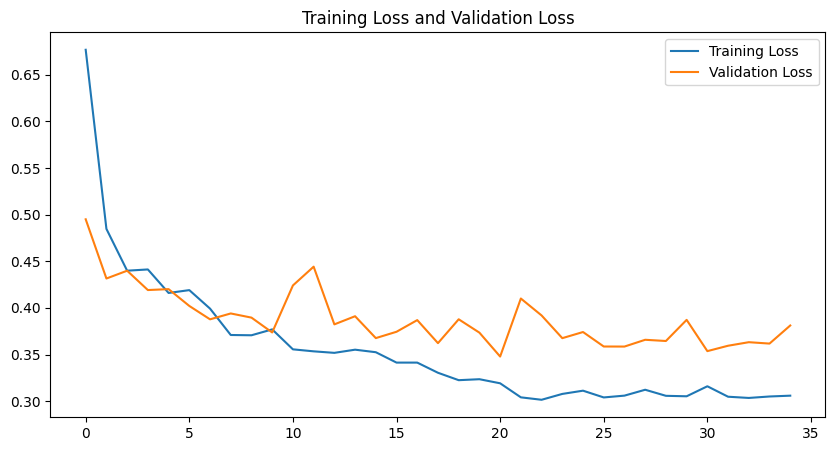

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training Loss and Validation Loss')
plt.legend()
plt.show(block=False)

In [ ]:
import torch
import numpy as np
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score

# Function to compute metrics
def compute_metrics(true_mask, pred_mask):
    # Flatten masks to 1D arrays
    true_mask_flat = true_mask.flatten()
    pred_mask_flat = pred_mask.flatten()

    # Ensure both are binary (0 or 1)
    true_mask_flat = (true_mask_flat > 0.5).astype(np.uint8)
    pred_mask_flat = (pred_mask_flat > 0.5).astype(np.uint8)

    # Calculate precision, recall, accuracy, F1 score
    precision = precision_score(true_mask_flat, pred_mask_flat)
    recall = recall_score(true_mask_flat, pred_mask_flat)
    accuracy = accuracy_score(true_mask_flat, pred_mask_flat)
    f1 = f1_score(true_mask_flat, pred_mask_flat)

    return precision, recall, accuracy, f1

# Function to validate model and compute metrics
def valid(model, data_loader, device):
    model.eval()
    test_loss = 0
    dice_loss_list = []
    precision_list = []
    recall_list = []
    accuracy_list = []
    f1_list = []

    with torch.no_grad():
        for images, true_masks in data_loader:
            images = images.to(device)
            true_masks = true_masks.to(device)

            # Get model predictions
            preds = model(images)

            # Compute Dice loss (assuming you already implemented Dice loss in your notebook)
            dice_loss = DiceLoss()(preds, true_masks)  # Replace this with your actual Dice Loss function
            dice_loss_list.append(dice_loss.item())

            # Convert predictions and masks to CPU and numpy for metric calculation
            preds = preds.cpu().numpy()
            true_masks = true_masks.cpu().numpy()

            # Iterate through each image in the batch
            for pred_mask, true_mask in zip(preds, true_masks):
                # Ensure both predicted mask and true mask are binary
                pred_mask = (pred_mask > 0.5).astype(np.uint8)  # Binarize predictions
                true_mask = (true_mask > 0.5).astype(np.uint8)  # Binarize ground truth

                # Compute precision, recall, accuracy, and F1 score
                precision, recall, accuracy, f1 = compute_metrics(true_mask, pred_mask)
                precision_list.append(precision)
                recall_list.append(recall)
                accuracy_list.append(accuracy)
                f1_list.append(f1)

    avg_precision = np.mean(precision_list)
    avg_recall = np.mean(recall_list)
    avg_accuracy = np.mean(accuracy_list)
    avg_f1 = np.mean(f1_list)
    avg_dice_loss = np.mean(dice_loss_list)

    print(f'Precision: {avg_precision}')
    print(f'Recall: {avg_recall}')
    print(f'Accuracy: {avg_accuracy}')
    print(f'F1 Score: {avg_f1}')
    print(f'Average Dice Loss: {avg_dice_loss}')

    return avg_dice_loss, avg_precision, avg_recall, avg_accuracy, avg_f1

# Example usage with your test_loader
test_loss, precision, recall, accuracy, f1 = valid(model2, test_loader, device)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.p

Precision: 0.608762196853559
Recall: 0.6732396500825387
Accuracy: 0.972874273255814
F1 Score: 0.5947694248470548
Average Dice Loss: 0.3507547842131721


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.p

Precision: 0.608762196853559
Recall: 0.6732396500825387
Accuracy: 0.972874273255814
F1 Score: 0.5947694248470548
Average Dice Loss: 0.3507547842131721


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


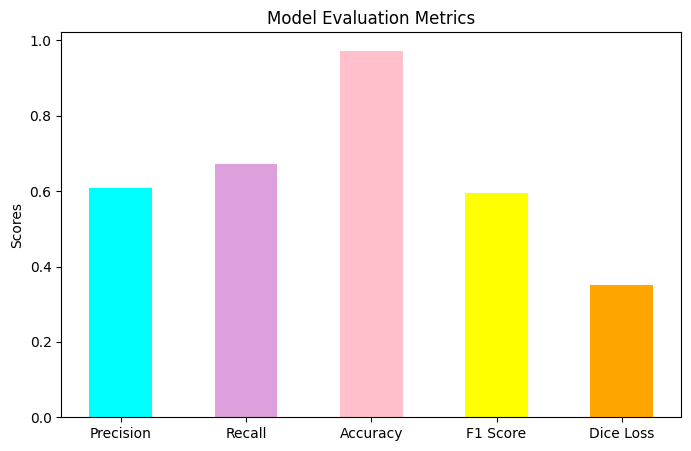

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Example usage with your test_loader (assuming valid function has been run)
test_loss, precision, recall, accuracy, f1 = valid(model2, test_loader, device)

# Create a list of metrics and their values
metrics = ['Precision', 'Recall', 'Accuracy', 'F1 Score', 'Dice Loss']
values = [precision, recall, accuracy, f1, test_loss]

# Plot the bar graph
plt.figure(figsize=(8, 5))
plt.bar(metrics, values, color=['cyan', 'plum', 'pink', 'yellow', 'orange'],width=0.5,align='center')

# Add labels and title
plt.ylabel('Scores')
plt.title('Model Evaluation Metrics')

# Show the plot
plt.show()


In [ ]:
# Model Inferencing
test_loss = valid(model2,test_loader,device)
print(f'Test data DiceLoss, IOU : {test_loss}')

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.p

Precision: 0.608762196853559
Recall: 0.6732396500825387
Accuracy: 0.972874273255814
F1 Score: 0.5947694248470548
Average Dice Loss: 0.3507547842131721
Test data DiceLoss, IOU : (0.3507547842131721, 0.608762196853559, 0.6732396500825387, 0.972874273255814, 0.5947694248470548)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


The given code snippet performs model inferencing on a test dataset and calculates the test loss using a validation function. Here's a breakdown of what the code is doing:

Model Inferencing: The model model2 is evaluated on the test_loader dataset.

Validation Function: The valid function is called to compute the loss on the
test dataset. This function typically evaluates the model on the dataset and returns the loss.

Loss Function: loss_fn is the loss function used to calculate the loss.

Device: The device (e.g., CPU or GPU) where the computations are performed is specified by device.

Print Loss: The calculated test loss (e.g., Dice Loss or IOU) is printed.

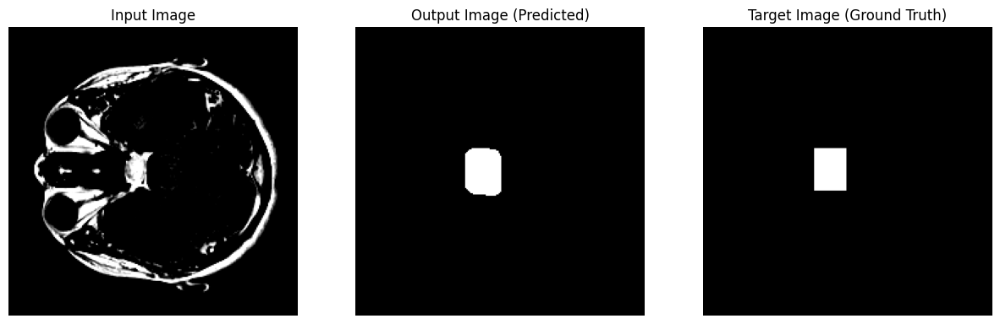

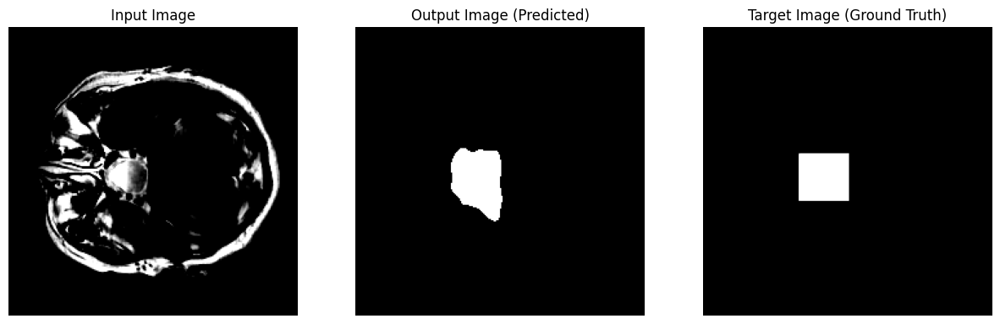

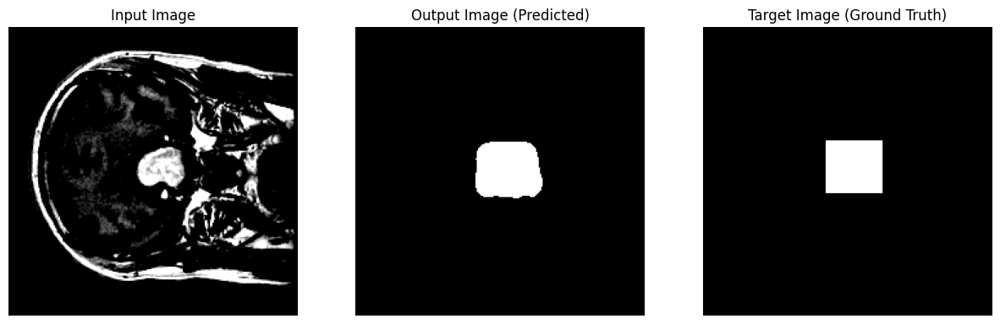

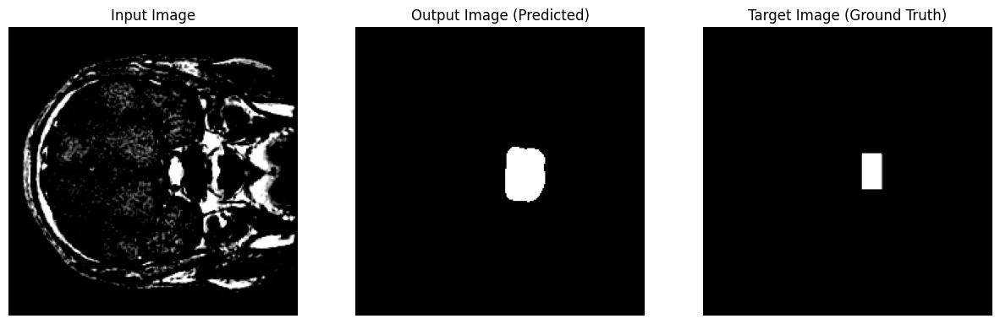

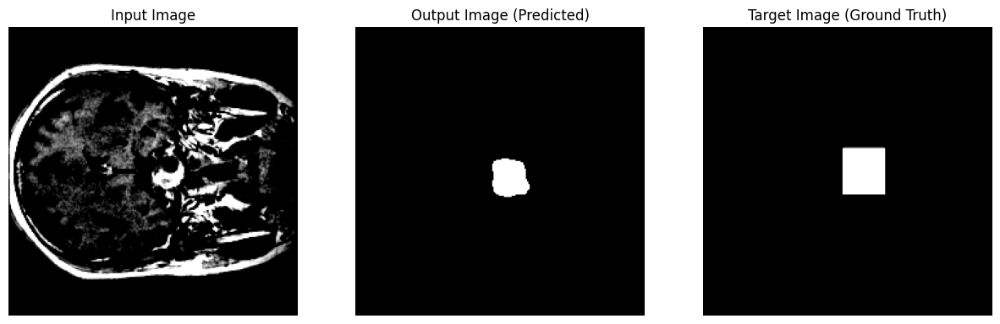

...

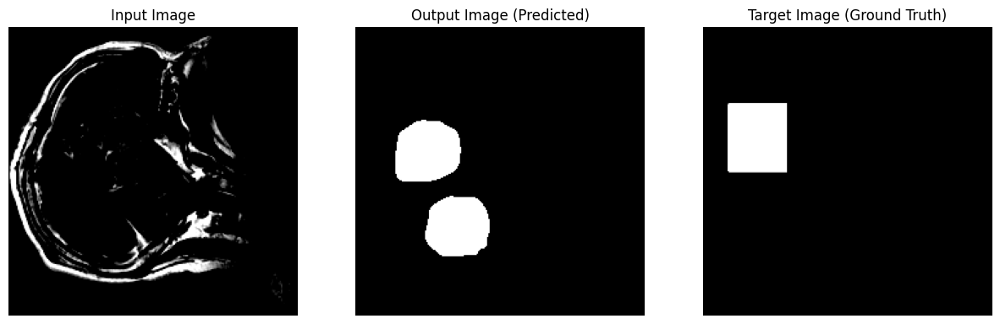

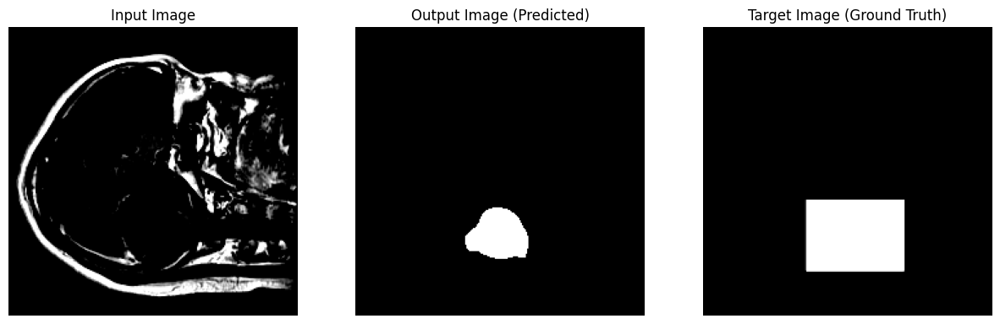

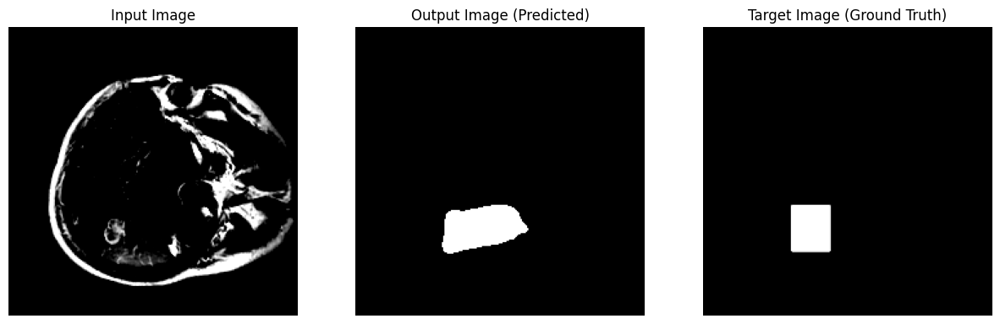

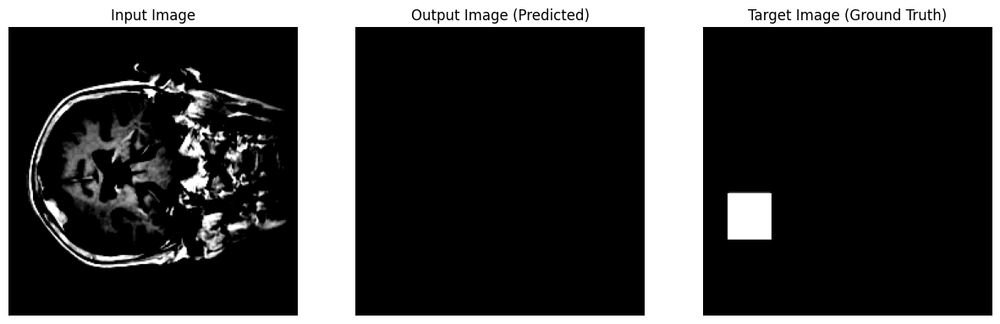

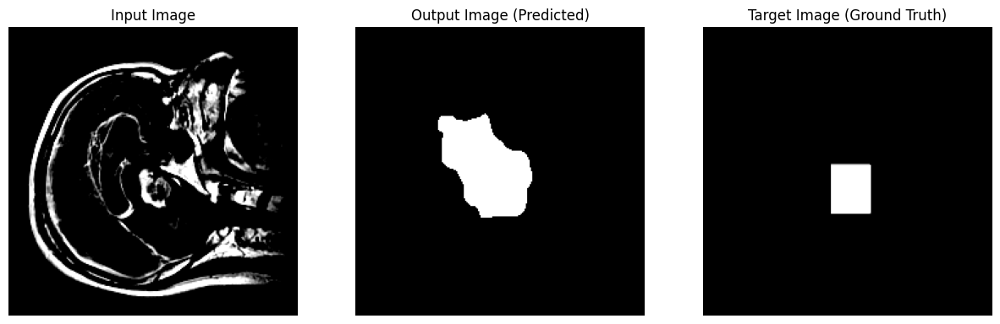

In [ ]:
def visualize_input_output_target(input_image, output_image, target_image):
    input_image = input_image.cpu()
    output_image = output_image.cpu()
    target_image = target_image.cpu()

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    axes[0].imshow(input_image.squeeze().numpy(), cmap='gray')
    axes[0].set_title('Input Image')
    axes[0].axis('off')

    axes[1].imshow(output_image.squeeze().numpy(), cmap='gray')
    axes[1].set_title('Output Image (Predicted)')
    axes[1].axis('off')

    axes[2].imshow(target_image.squeeze().numpy(), cmap='gray')
    axes[2].set_title('Target Image (Ground Truth)')
    axes[2].axis('off')

    plt.show()
    fig.savefig("output.png")


with torch.no_grad():
    for batch, (X, y) in enumerate(valid_loader):
        X = X.to(DEVICE, dtype=torch.float32)
        y = y.to(DEVICE, dtype=torch.float32)

        y_pred_logits = model2(X)

        y_pred = y_pred_logits[0]  # Adjust this index as needed
        y_pred_binary = (y_pred > 0.5).float()
        visualize_input_output_target(X[0], y_pred_binary[0], y[0])

This code visualizes the input image, predicted output, and target image for a batch of data using Matplotlib. The `visualize_input_output_target` function plots these images side by side. Inside a loop, the model predicts the output for each batch from the validation data loader. The input, target, and predicted output images are moved to the CPU, and binary thresholding is applied to the predictions. Finally, the visualization function is called to display the images and save the figure as "output.png".


#Model 3 : Efficient Unet++ from [segmentation_models_pytorch]

In [ ]:
import segmentation_models_pytorch as smp
import torch.nn as nn
import torchsummary

DEVICE = 'cuda'
ENCODER_WEIGHTS = 'imagenet'
LEARNING_RATE = 1e-4
ACTIVATION = None
ENCODER = "timm-efficientnet-b5"

model3 = smp.EfficientUnetPlusPlus(
    in_channels=1,
    classes=1,
    encoder_weights=ENCODER_WEIGHTS,
    activation = ACTIVATION,
    encoder_name = ENCODER
)

# Define the optimizer
model3.to(DEVICE)
print(torchsummary.summary(model3, (1, 224, 224)))
optimizer3 = torch.optim.Adam(filter(lambda p: p.requires_grad, model3.parameters()), lr=LEARNING_RATE)

Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_b5_ra-9a3e5369.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientnet_b5_ra-9a3e5369.pth
100%|██████████| 117M/117M [00:02<00:00, 43.6MB/s]


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 48, 112, 112]             432
       BatchNorm2d-2         [-1, 48, 112, 112]              96
             Swish-3         [-1, 48, 112, 112]               0
            Conv2d-4         [-1, 48, 112, 112]             432
       BatchNorm2d-5         [-1, 48, 112, 112]              96
             Swish-6         [-1, 48, 112, 112]               0
            Conv2d-7             [-1, 12, 1, 1]             588
             Swish-8             [-1, 12, 1, 1]               0
            Conv2d-9             [-1, 48, 1, 1]             624
          Sigmoid-10             [-1, 48, 1, 1]               0
    SqueezeExcite-11         [-1, 48, 112, 112]               0
           Conv2d-12         [-1, 24, 112, 112]           1,152
      BatchNorm2d-13         [-1, 24, 112, 112]              48
         Identity-14         [-1, 24, 1

In [ ]:
from tqdm import tqdm
from IPython.display import clear_output

best_val_loss = float('inf')  # Initialize the best validation loss
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check for CUDA availability
train_losses = []
val_losses = []
train_ious = []
val_ious = []
num_no_improve = 0  # Counter for early stopping

model3.to(device)  # Move the model to the appropriate device (GPU/CPU)

for epoch in range(NUM_EPOCHS):
    # Training step
    train_loss, train_iou = train(model3, optimizer3, loss_fn, train_loader, device)

    # Validation step
    val_loss, val_iou = validate(model3, valid_loader, device)  # Remove `loss_fn` from this call

    # Append training and validation losses/IoU scores for tracking
    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_ious.append(train_iou)
    val_ious.append(val_iou)

    # Clear previous outputs and print the progress
    clear_output(wait=True)
    print(f'Epoch {epoch+1}/{NUM_EPOCHS}, Train Loss: {train_loss:.4f}, Train IoU: {train_iou:.4f}')
    print(f'Validation Loss: {val_loss:.4f}, Validation IoU: {val_iou:.4f}')

    # Check if the current validation loss is the best we've seen
    if val_loss < best_val_loss:
        best_val_loss = val_loss  # Update the best validation loss
        print("Saving the model with the best validation loss")
        torch.save(model3.state_dict(), checkpoints_path)  # Save the best model

    # If the validation loss has not improved, load the best model
    if val_loss > best_val_loss:
        best_dict = torch.load(checkpoints_path)  # Load the best model
        print('Loading the best model (no improvement)')
        model3.load_state_dict(best_dict)

    # Early stopping logic
    if len(val_losses) > 1:
        if val_loss >= best_val_loss:  # No improvement in validation loss
            num_no_improve += 1
        else:
            num_no_improve = 0  # Reset the counter if there's an improvement

    if num_no_improve >= 7:  # Early stopping condition after 7 consecutive non-improvements
        print("Early stopping triggered due to lack of improvement")
        break


100%|██████████| 188/188 [01:46<00:00,  1.76it/s]


Epoch 1/35, Train Loss: 0.7400, Train IoU: 0.1861
Validation Loss: 0.5204, Validation IoU: 0.0368
Saving the model with the best validation loss


100%|██████████| 188/188 [01:46<00:00,  1.76it/s]


Epoch 2/35, Train Loss: 0.4710, Train IoU: 0.3977
Validation Loss: 0.3747, Validation IoU: 0.0368
Saving the model with the best validation loss


100%|██████████| 188/188 [01:46<00:00,  1.77it/s]


Epoch 3/35, Train Loss: 0.3622, Train IoU: 0.4911
Validation Loss: 0.3177, Validation IoU: 0.0368
Saving the model with the best validation loss


100%|██████████| 188/188 [01:46<00:00,  1.77it/s]


Epoch 4/35, Train Loss: 0.3068, Train IoU: 0.5453
Validation Loss: 0.3345, Validation IoU: 0.0368


<ipython-input-42-3731465e3078>:40: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_dict = torch.load(checkpoints_path)  # Load the best model


Loading the best model (no improvement)


100%|██████████| 188/188 [01:46<00:00,  1.76it/s]


Epoch 5/35, Train Loss: 0.3060, Train IoU: 0.5471
Validation Loss: 0.3247, Validation IoU: 0.0368
Loading the best model (no improvement)


100%|██████████| 188/188 [01:46<00:00,  1.77it/s]


Epoch 6/35, Train Loss: 0.3019, Train IoU: 0.5508
Validation Loss: 0.3095, Validation IoU: 0.0368
Saving the model with the best validation loss


100%|██████████| 188/188 [01:46<00:00,  1.77it/s]


Epoch 7/35, Train Loss: 0.2676, Train IoU: 0.5890
Validation Loss: 0.3191, Validation IoU: 0.0368
Loading the best model (no improvement)


100%|██████████| 188/188 [01:46<00:00,  1.77it/s]


Epoch 8/35, Train Loss: 0.2673, Train IoU: 0.5908
Validation Loss: 0.2975, Validation IoU: 0.0368
Saving the model with the best validation loss
Early stopping triggered due to lack of improvement


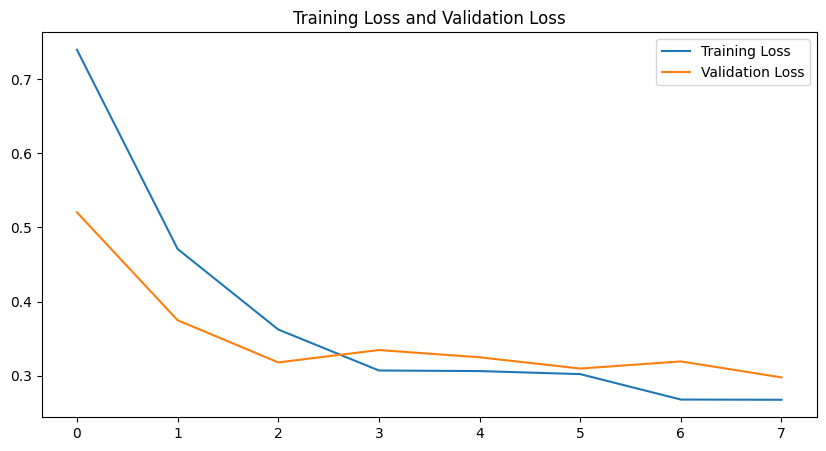

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training Loss and Validation Loss')
plt.legend()
plt.show(block=False)

In [ ]:
import torch
import numpy as np
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score

# Function to compute metrics
def compute_metrics(true_mask, pred_mask):
    # Flatten masks to 1D arrays
    true_mask_flat = true_mask.flatten()
    pred_mask_flat = pred_mask.flatten()

    # Ensure both are binary (0 or 1)
    true_mask_flat = (true_mask_flat > 0.5).astype(np.uint8)
    pred_mask_flat = (pred_mask_flat > 0.5).astype(np.uint8)

    # Calculate precision, recall, accuracy, F1 score
    precision = precision_score(true_mask_flat, pred_mask_flat)
    recall = recall_score(true_mask_flat, pred_mask_flat)
    accuracy = accuracy_score(true_mask_flat, pred_mask_flat)
    f1 = f1_score(true_mask_flat, pred_mask_flat)

    return precision, recall, accuracy, f1

# Function to validate model and compute metrics
def valid(model, data_loader, device):
    model.eval()
    test_loss = 0
    dice_loss_list = []
    precision_list = []
    recall_list = []
    accuracy_list = []
    f1_list = []

    with torch.no_grad():
        for images, true_masks in data_loader:
            images = images.to(device)
            true_masks = true_masks.to(device)

            # Get model predictions
            preds = model(images)

            # Compute Dice loss (assuming you already implemented Dice loss in your notebook)
            dice_loss = DiceLoss()(preds, true_masks)  # Replace this with your actual Dice Loss function
            dice_loss_list.append(dice_loss.item())

            # Convert predictions and masks to CPU and numpy for metric calculation
            preds = preds.cpu().numpy()
            true_masks = true_masks.cpu().numpy()

            # Iterate through each image in the batch
            for pred_mask, true_mask in zip(preds, true_masks):
                # Ensure both predicted mask and true mask are binary
                pred_mask = (pred_mask > 0.5).astype(np.uint8)  # Binarize predictions
                true_mask = (true_mask > 0.5).astype(np.uint8)  # Binarize ground truth

                # Compute precision, recall, accuracy, and F1 score
                precision, recall, accuracy, f1 = compute_metrics(true_mask, pred_mask)
                precision_list.append(precision)
                recall_list.append(recall)
                accuracy_list.append(accuracy)
                f1_list.append(f1)

    avg_precision = np.mean(precision_list)
    avg_recall = np.mean(recall_list)
    avg_accuracy = np.mean(accuracy_list)
    avg_f1 = np.mean(f1_list)
    avg_dice_loss = np.mean(dice_loss_list)

    print(f'Precision: {avg_precision}')
    print(f'Recall: {avg_recall}')
    print(f'Accuracy: {avg_accuracy}')
    print(f'F1 Score: {avg_f1}')
    print(f'Average Dice Loss: {avg_dice_loss}')

    return avg_dice_loss, avg_precision, avg_recall, avg_accuracy, avg_f1

# Example usage with your test_loader
test_loss, precision, recall, accuracy, f1 = valid(model3, test_loader, device)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Precision: 0.6563097290998675
Recall: 0.7310204873365386
Accuracy: 0.974515936461794
F1 Score: 0.6580644218062183
Average Dice Loss: 0.31252409793712477


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Precision: 0.6563097290998675
Recall: 0.7310204873365386
Accuracy: 0.974515936461794
F1 Score: 0.6580644218062183
Average Dice Loss: 0.31252409793712477


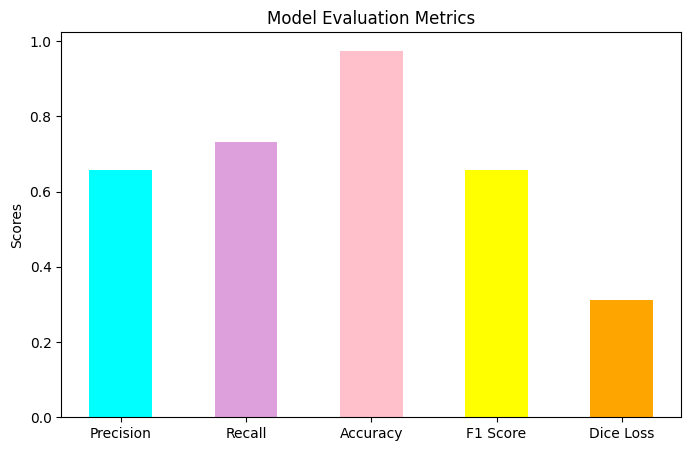

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Example usage with your test_loader (assuming valid function has been run)
test_loss, precision, recall, accuracy, f1 = valid(model3, test_loader, device)

# Create a list of metrics and their values
metrics = ['Precision', 'Recall', 'Accuracy', 'F1 Score', 'Dice Loss']
values = [precision, recall, accuracy, f1, test_loss]

# Plot the bar graph
plt.figure(figsize=(8, 5))
plt.bar(metrics, values, color=['cyan', 'plum', 'pink', 'yellow', 'orange'],width=0.5,align='center')

# Add labels and title
plt.ylabel('Scores')
plt.title('Model Evaluation Metrics')

# Show the plot
plt.show()


In [ ]:
test_loss = valid(model3,test_loader,device)
print(f'Test data DiceLoss, IOU : {test_loss}')

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Precision: 0.6563097290998675
Recall: 0.7310204873365386
Accuracy: 0.974515936461794
F1 Score: 0.6580644218062183
Average Dice Loss: 0.31252409793712477
Test data DiceLoss, IOU : (0.31252409793712477, 0.6563097290998675, 0.7310204873365386, 0.974515936461794, 0.6580644218062183)


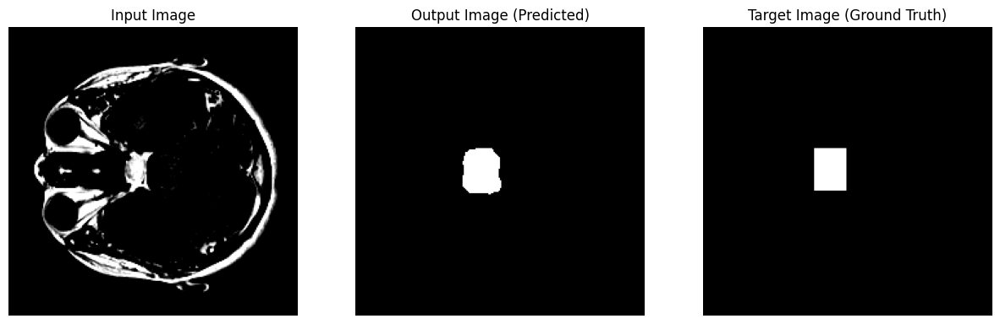

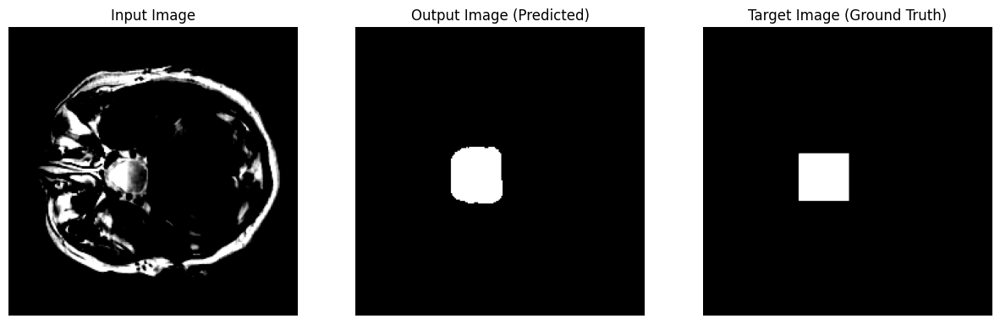

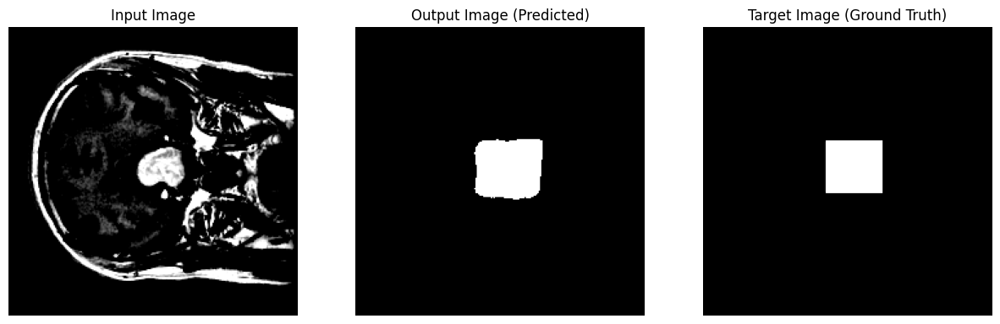

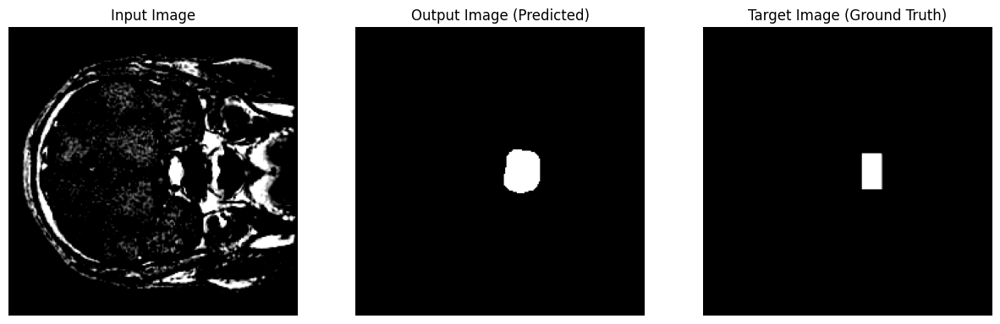

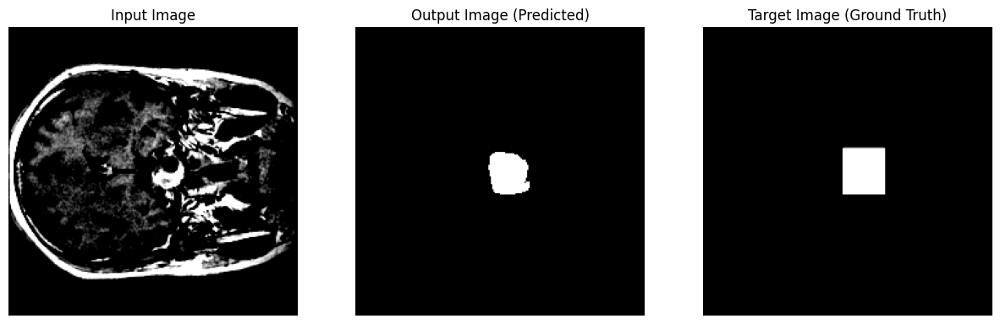

...

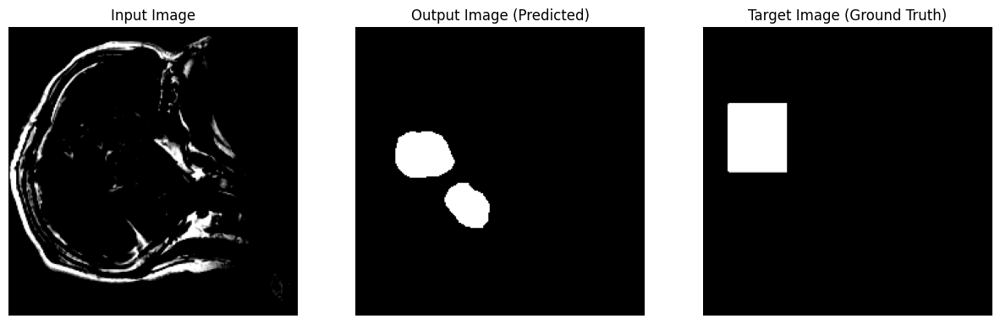

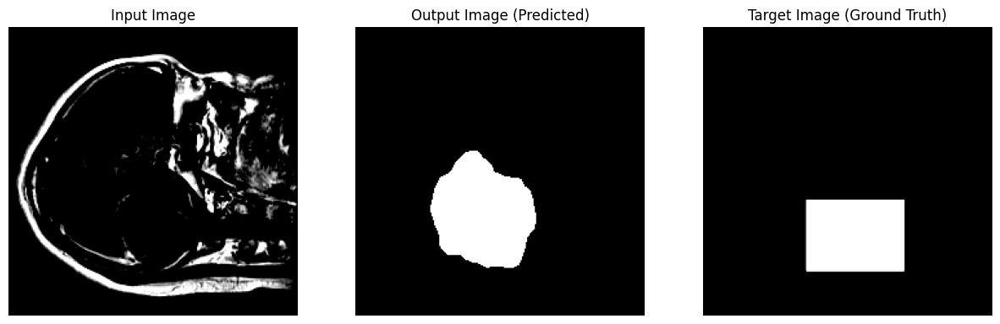

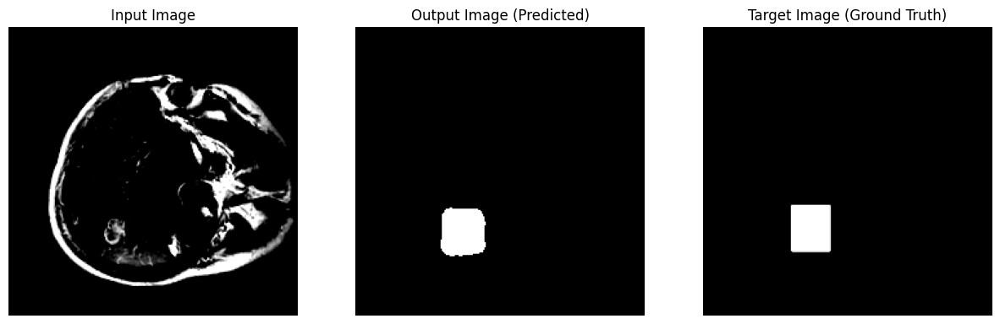

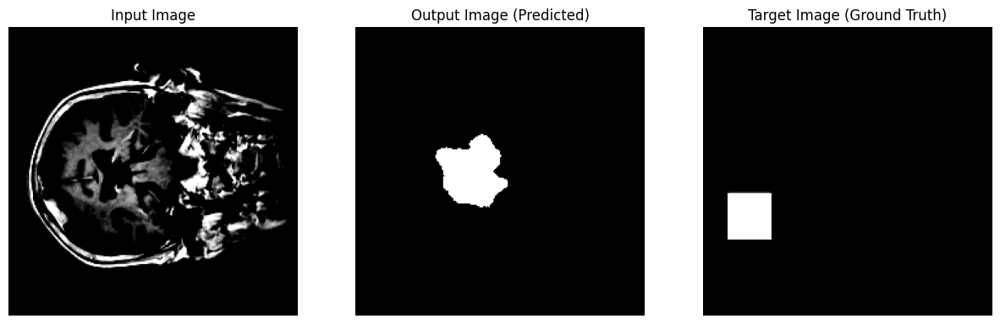

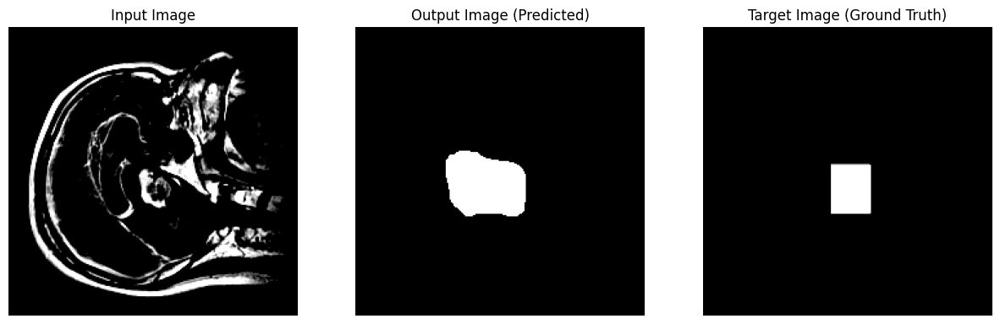

In [ ]:
def visualize_input_output_target(input_image, output_image, target_image):
    input_image = input_image.cpu()
    output_image = output_image.cpu()
    target_image = target_image.cpu()

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    axes[0].imshow(input_image.squeeze().numpy(), cmap='gray')
    axes[0].set_title('Input Image')
    axes[0].axis('off')

    axes[1].imshow(output_image.squeeze().numpy(), cmap='gray')
    axes[1].set_title('Output Image (Predicted)')
    axes[1].axis('off')

    axes[2].imshow(target_image.squeeze().numpy(), cmap='gray')
    axes[2].set_title('Target Image (Ground Truth)')
    axes[2].axis('off')

    plt.show()
    fig.savefig("output.png")

with torch.no_grad():
    for batch, (X, y) in enumerate(valid_loader):
        X = X.to(DEVICE, dtype=torch.float32)
        y = y.to(DEVICE, dtype=torch.float32)

        y_pred_logits = model3(X)
        y_pred = y_pred_logits[0]
        y_pred_binary = (y_pred > 0.7).float()

        visualize_input_output_target(X[0], y_pred_binary[0], y[0])

In [ ]:
# Updated with new legends and pastel colors

# Pastel colors for the bars
colors = ['palegreen', 'coral', 'violet']

# Setting up bar width
bar_width = 0.2
r1 = np.arange(len(metrics))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Plotting the bars with pastel colors
plt.figure(figsize=(10, 6))
plt.bar(r1, model1_scores, color=colors[0], width=bar_width, edgecolor='grey', label='UNet')
plt.bar(r2, model2_scores, color=colors[1], width=bar_width, edgecolor='grey', label='UNet with ResNet')
plt.bar(r3, model3_scores, color=colors[2], width=bar_width, edgecolor='grey', label='UNet++')

# Adding labels
plt.xlabel('Metrics', fontweight='bold')
plt.xticks([r + bar_width for r in range(len(metrics))], metrics)
plt.ylabel('Scores', fontweight='bold')
plt.title('Performance Comparison of UNet, UNet with ResNet, and UNet++')
plt.legend()

# Display the graph
plt.tight_layout()
plt.show()


NameError: name 'model1_scores' is not defined

<Figure size 1000x600 with 0 Axes>